In [22]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../../../')

import warnings
import pytest
from pathlib import Path
from collections import defaultdict

from fiberphotometry.config import PLOTTING_CONFIG
from fiberphotometry.data.data_loading import DataContainer, load_all_sessions
from fiberphotometry.data.session_loading import populate_containers
from fiberphotometry.data.syncer import sync_session
from fiberphotometry.data.timepoint_processing import create_event_idxs_container_for_sessions
from fiberphotometry.processing.plotting_setup import PlottingSetup
from fiberphotometry.processing.signal_info_setup import assign_sessions_signal_info

# adjust to your project layout
SRC = Path("/Users/fsp585/Desktop/GetherLabCode/FiberphotometryCode/src/trial_Gq-DREADD_CPT")
sessions = load_all_sessions(
            baseline_dir=str(SRC),
            session_type="cpt",
            remove_bad_signal_sessions=True
        )
populate_containers(sessions)
for session in sessions:
    sync_session(session)
def actions_attr_dict_for():
    return {
            "Hit":      "hit",
            "Mistake":  "mistake",
            "Missed Hit":"miss",
            "Correction Trial Correct Rejection":"cor_reject",
            "Correct Rejection":"cor_reject"
        }

def reward_attr_dict_for():
    return {"Reward Collected Start ITI":"reward_collect"}
create_event_idxs_container_for_sessions(
    sessions,
    actions_attr_dict_for(),
    reward_attr_dict_for())
# 3) Plotting setup
PlottingSetup(**PLOTTING_CONFIG['cpt']) \
    .apply_plotting_setup_to_sessions(sessions)

# 4) Signal‐info
assign_sessions_signal_info(sessions)
import numpy as np
import matplotlib.pyplot as plt
def update_genotypes(sessions, mice_gen_dict):
    """
    Updates the genotypes for a list of sessions based on the provided genotype mapping.
    Prints whether the genotypes are valid ('TH-Cre', 'Wildtype') 
    and the number of genotype changes made.

    Parameters:
    - sessions: A list of session objects to process.
    - mice_gen_dict: A dictionary mapping mouse IDs to new genotypes.
    """
    geno_mapping = {
        "Cre": "TH-Cre",
        "WT": "Wildtype"
    }
    # Map mice_gen_dict to use TH-Cre and Wildtype
    mapped_genotypes = {k: geno_mapping[v] for k, v in mice_gen_dict.items()}
    
    # Initialize counters and trackers
    valid_genotypes = {'TH-Cre', 'Wildtype'}
    all_genotypes = set()
    genotype_changes = 0

    for session in sessions:
        original_genotype = session.genotype
        int_id = int(session.mouse_id)
        
        if int_id in mapped_genotypes:
            session.genotype = mapped_genotypes[int_id]
            # Count changes if the genotype was updated
            if session.genotype != original_genotype:
                genotype_changes += 1
        
        all_genotypes.add(session.genotype)
    
    # Print results
    if all_genotypes.issubset(valid_genotypes):
        print(f"Valid genotypes found: {all_genotypes}")
    else:
        print(f"Invalid genotypes found: {all_genotypes}")
    
    print(f"Genotype changes made: {genotype_changes}")
mice_gen_dict = {
    69: "Cre",
    71: "WT",
    73: "Cre",
    75: "WT",
    77: "Cre",
    79: "WT",
    85: "WT",
    87: "WT",
    135: "WT",
    137: "WT",
    139: "Cre",
    133: "WT",
    127: "WT",
    125: "WT",
    129: "Cre",
    131: "WT",
    143: "Cre",
    145: "WT",
    147: "WT",
    157: "Cre",
    159: "Cre",
    161: "WT",
    171: "Cre",
    173: "Cre"
}
update_genotypes(sessions, mice_gen_dict)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Processing trial directories:   0%|          | 0/54 [00:00<?, ?it/s]/Users/fsp585/Desktop/GetherLabCode/FiberphotometryCode/fiberphotometry/notebooks/leonie/../../../fiberphotometry/data/data_loading.py:194: UserWarning: Drug info 'CNO 2.0' has only two tokens; assuming metric is 'mg/kg'.
  warnings.warn(
/Users/fsp585/Desktop/GetherLabCode/FiberphotometryCode/fiberphotometry/notebooks/leonie/../../../fiberphotometry/data/data_loading.py:194: UserWarning: Drug info 'CNO 0.1' has only two tokens; assuming metric is 'mg/kg'.
  warnings.warn(
/Users/fsp585/Desktop/GetherLabCode/FiberphotometryCode/fiberphotometry/notebooks/leonie/../../../fiberphotometry/data/data_loading.py:194: UserWarning: Drug info 'CNO 0.5' has only two tokens; assuming metric is 'mg/kg'.
  warnings.warn(
/Users/fsp585/Desktop/GetherLabCode/FiberphotometryCode/fiberphotometry/notebooks/leonie/../../../fiberphotometry/data/data_loading.py:194: UserWarning: Drug info 'CNO 2.0' has only two tokens; assuming metric is 'm

Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating 'phot_470': removed 1 rows
Truncating '

In [23]:
# brain_reg_to_color = {'VS': 'purple',
#                       'DMS': 'forestgreen',
#                       'DLS': 'C0'}

brain_reg_to_color = {'LH': 'orange',
                      'mPFC': 'cornflowerblue'}

In [24]:
avail_events = set()

In [25]:
sessions[0].signal_meta

{'signal_0': ('mPFC', 'left', 'G', 'G0'),
 'signal_1': ('LH', 'left', 'G', 'G2')}

In [26]:
sessions[0].dfs.data['phot_470']

,FrameCounter,SystemTimestamp,LedState,signal_0,signal_1,sec_from_zero,sec_from_trial_start,signal_0_dff,signal_1_dff
0,1,1913.013536,2,0.004137,0.003932,0.000000,-2478.374672,-27.078653,-9.333769
1,3,1913.063552,2,0.004328,0.004020,0.050016,-2478.324656,-26.225867,-9.091248
2,5,1913.113536,2,0.004153,0.003932,0.100000,-2478.274672,-26.995399,-9.330578
3,7,1913.163552,2,0.004325,0.004032,0.150016,-2478.224656,-26.214616,-9.049764
4,9,1913.213536,2,0.004343,0.004032,0.200000,-2478.174672,-26.144863,-9.051359
...,...,...,...,...,...,...,...,...,...
98336,196673,6829.852704,2,0.004308,0.004105,4916.839168,2438.464496,-26.291120,-8.864682
98337,196675,6829.902720,2,0.004287,0.004098,4916.889184,2438.514512,-26.399124,-8.888615
98338,196677,6829.952704,2,0.004321,0.004115,4916.939168,2438.564496,-26.250618,-8.832771
98339,196679,6830.002720,2,0.004312,0.004111,4916.989184,2438.614512,-26.302370,-8.839153


In [32]:
from fiberphotometry.analysis.timepoint_analysis import find_drug_split_x
from fiberphotometry import config

for session in sessions:
    for brain_region in session.brain_regions:

        # find the x position at which the injection peak has been passed within the trial
        threshold_x = find_drug_split_x(session, brain_region)
        br, _, channel = brain_region
        for event in config.all_event_types:
            curr_signal_info = session.signal_info.get((br, channel, event))
            if curr_signal_info is None:
                continue
            else:
                avail_events.add(event)

            signal_idx_ranges = curr_signal_info['signal_idx_ranges']

            # find the middle position (0 seconds) of the given signal
            thresholds = np.array([((tup[0] + tup[1]) // 2) for tup in signal_idx_ranges])

            # if the 0 seconds position is later than threshold x, we know that the signal is past the injection peak
            curr_signal_info["is_above_threshold"] = thresholds > threshold_x
            print(np.mean(thresholds > threshold_x))

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


In [29]:
session.signal_info.keys()

dict_keys([('LH', 'G', 'iti_touch'), ('LH', 'G', 'dispimg'), ('LH', 'G', 'hit'), ('LH', 'G', 'mistake'), ('LH', 'G', 'miss'), ('LH', 'G', 'cor_reject'), ('LH', 'G', 'reward_collect'), ('LH', 'G', 'before_dispimg_miss'), ('LH', 'G', 'before_dispimg_hit'), ('LH', 'G', 'before_dispimg_cor_reject'), ('LH', 'G', 'before_dispimg_mistake'), ('LH', 'G', 'after_dispimg_miss'), ('LH', 'G', 'after_dispimg_hit'), ('LH', 'G', 'after_dispimg_cor_reject'), ('LH', 'G', 'after_dispimg_mistake'), ('mPFC', 'G', 'iti_touch'), ('mPFC', 'G', 'dispimg'), ('mPFC', 'G', 'hit'), ('mPFC', 'G', 'mistake'), ('mPFC', 'G', 'miss'), ('mPFC', 'G', 'cor_reject'), ('mPFC', 'G', 'reward_collect'), ('mPFC', 'G', 'before_dispimg_miss'), ('mPFC', 'G', 'before_dispimg_hit'), ('mPFC', 'G', 'before_dispimg_cor_reject'), ('mPFC', 'G', 'before_dispimg_mistake'), ('mPFC', 'G', 'after_dispimg_miss'), ('mPFC', 'G', 'after_dispimg_hit'), ('mPFC', 'G', 'after_dispimg_cor_reject'), ('mPFC', 'G', 'after_dispimg_mistake')])

In [ ]:
# session_skips = ['T' + str(id) for id in list(range(1, 6)) + list(range(31, 35))]
# session_skips = ['T' + str(id) for id in list(range(1, 6))]
# session_skips = ['T' + str(id) for id in list(range(51, 55))]
# sessions = [s for s in sessions if s.trial_id.split('_')[0] in session_skips]

In [66]:
from collections import defaultdict
import numpy as np

# This script demonstrates how to build the `all_signals` dictionary
# with the mouse_id included in the key.

# --- Assume 'sessions' and 'config' objects are already defined ---

# Define your S+ and S- group sets
s_plus_events = {"before_dispimg_hit", "before_dispimg_miss"}
s_minus_events = {"before_dispimg_cor_reject", "before_dispimg_mistake"}

all_signal_groups = defaultdict(list)

for session in sessions:
    genotype = session.genotype
    mouse_id = session.mouse_id  # Get the mouse_id from the session
    dose = (session.drug_infos[0]['name'], session.drug_infos[0]['dose'])
    
    if mouse_id == '77':
        continue
    for event in config.all_event_types:
        for brain_region in config.all_brain_regions:
            curr_signal_info = session.signal_info.get((brain_region, 'G', event))
            if curr_signal_info is None:
                continue
            
            # --- KEY CHANGE: Add mouse_id to the key ---
            #curr_key = (genotype, mouse_id, dose, event, brain_region)
            curr_key = (genotype, dose, event, brain_region)
            
            # Determine if this event belongs to S+ or S-
            if event in s_plus_events:
                s_group = "S+"
            elif event in s_minus_events:
                s_group = "S-"
            else:
                s_group = None

            if dose[-1] is None or genotype=='Wildtype':
                all_signal_groups[curr_key + (None, )].append(
                    curr_signal_info['signal_matrix']
                )
                if s_group is not None:
                    # --- KEY CHANGE: Add mouse_id to the group key ---
                    group_key = (genotype, dose, s_group, brain_region)
                    all_signal_groups[group_key + (None, )].append(
                        curr_signal_info['signal_matrix']
                    )
            else:
                is_above_threshold = curr_signal_info["is_above_threshold"]
                
                # Original per-event key
                all_signal_groups[curr_key + (True, )].append(
                    curr_signal_info['signal_matrix'][is_above_threshold]
                )
                all_signal_groups[curr_key + (False, )].append(
                    curr_signal_info['signal_matrix'][~is_above_threshold]
                )
                
                # Group-level key (S+ or S-)
                if s_group is not None:
                    # --- KEY CHANGE: Add mouse_id to the group key ---
                    group_key = (genotype, dose, s_group, brain_region)
                    all_signal_groups[group_key + (True, )].append(
                        curr_signal_info['signal_matrix'][is_above_threshold]
                    )
                    all_signal_groups[group_key + (False, )].append(
                        curr_signal_info['signal_matrix'][~is_above_threshold]
                    )
                
# Now collapse lists into arrays, removing keys that have no data
all_signals = {
    k: np.vstack(v) for k, v in all_signal_groups.items() if len(v) != 0
}

print("`all_signals` dictionary created with mouse_id in keys.")

`all_signals` dictionary created with mouse_id in keys.


In [67]:
all_signals.keys()

dict_keys([('Wildtype', ('Vehicle', None), 'hit', 'LH', None), ('Wildtype', ('Vehicle', None), 'hit', 'mPFC', None), ('Wildtype', ('Vehicle', None), 'mistake', 'LH', None), ('Wildtype', ('Vehicle', None), 'mistake', 'mPFC', None), ('Wildtype', ('Vehicle', None), 'miss', 'LH', None), ('Wildtype', ('Vehicle', None), 'miss', 'mPFC', None), ('Wildtype', ('Vehicle', None), 'cor_reject', 'LH', None), ('Wildtype', ('Vehicle', None), 'cor_reject', 'mPFC', None), ('Wildtype', ('Vehicle', None), 'reward_collect', 'LH', None), ('Wildtype', ('Vehicle', None), 'reward_collect', 'mPFC', None), ('Wildtype', ('Vehicle', None), 'before_dispimg_mistake', 'LH', None), ('Wildtype', ('Vehicle', None), 'S-', 'LH', None), ('Wildtype', ('Vehicle', None), 'before_dispimg_mistake', 'mPFC', None), ('Wildtype', ('Vehicle', None), 'S-', 'mPFC', None), ('Wildtype', ('Vehicle', None), 'before_dispimg_hit', 'LH', None), ('Wildtype', ('Vehicle', None), 'S+', 'LH', None), ('Wildtype', ('Vehicle', None), 'before_dispimg

In [70]:
from scipy.ndimage import uniform_filter1d

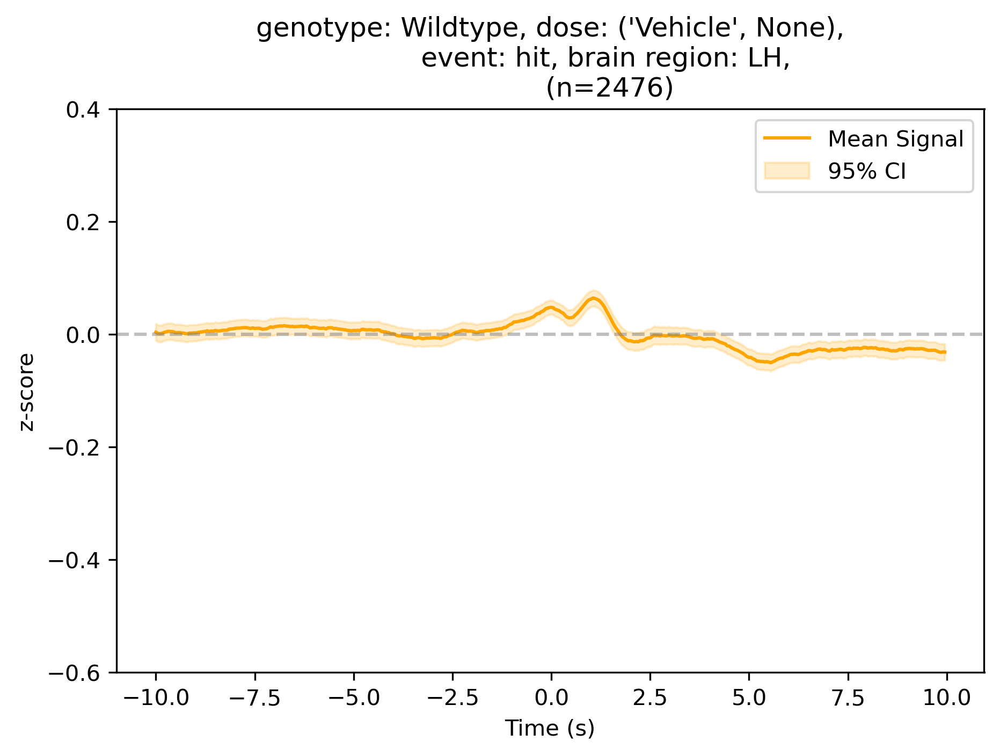

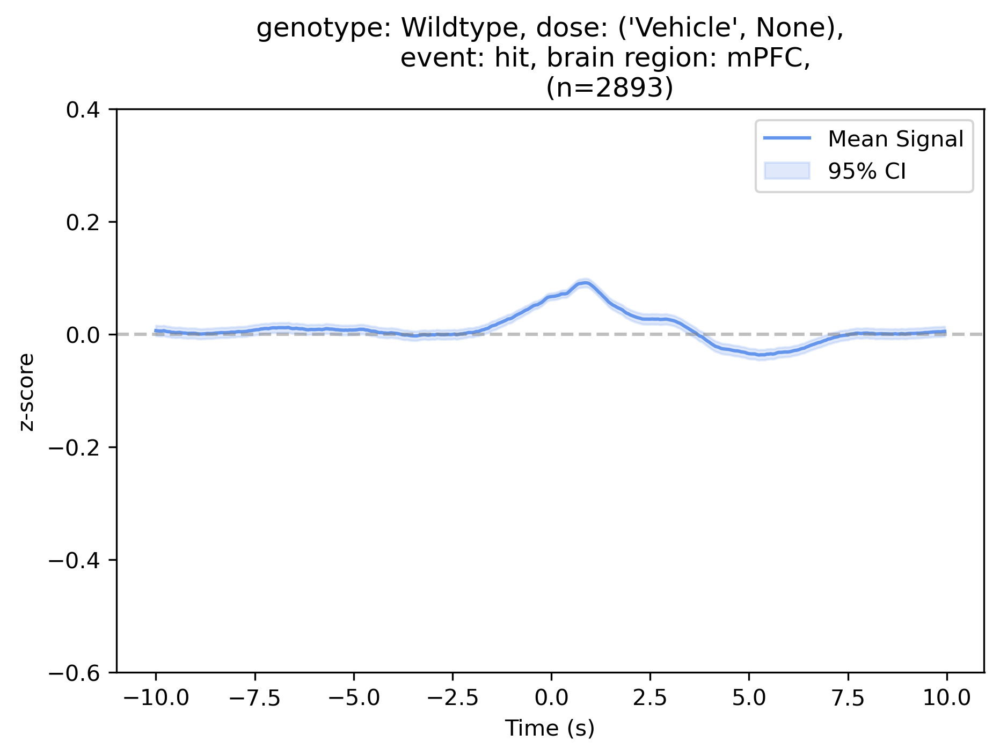

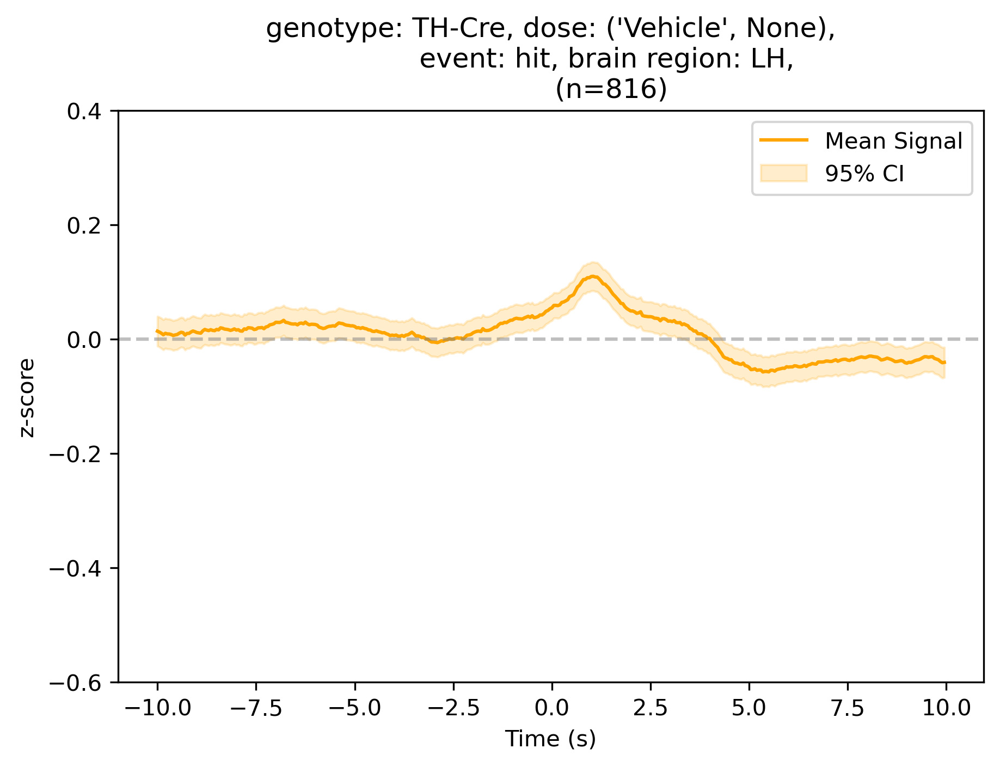

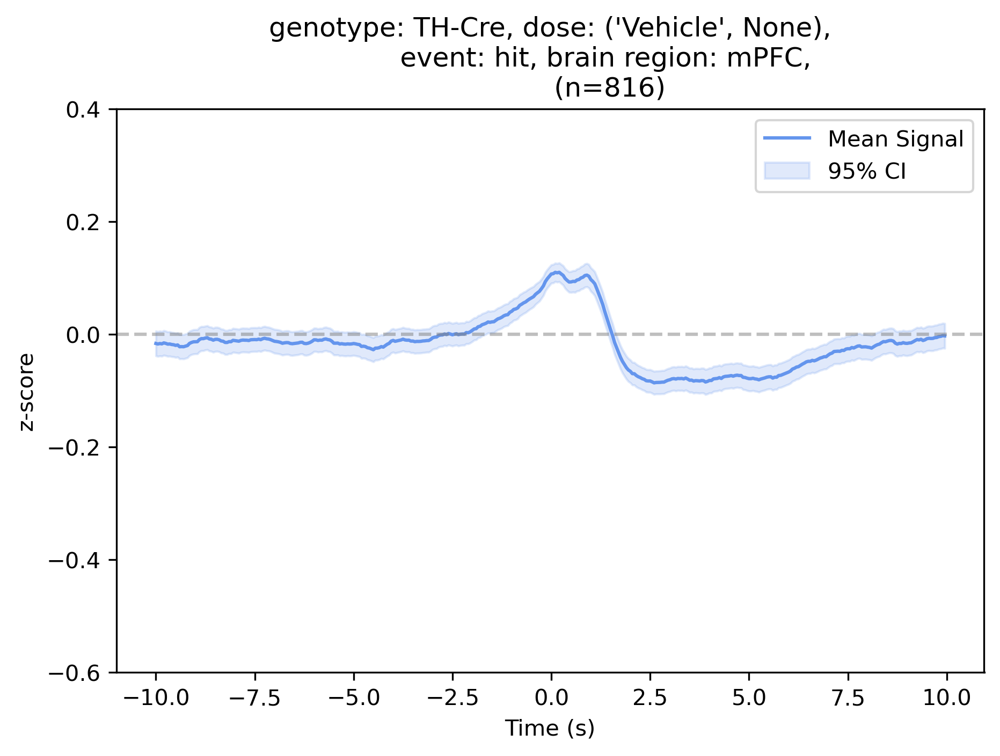

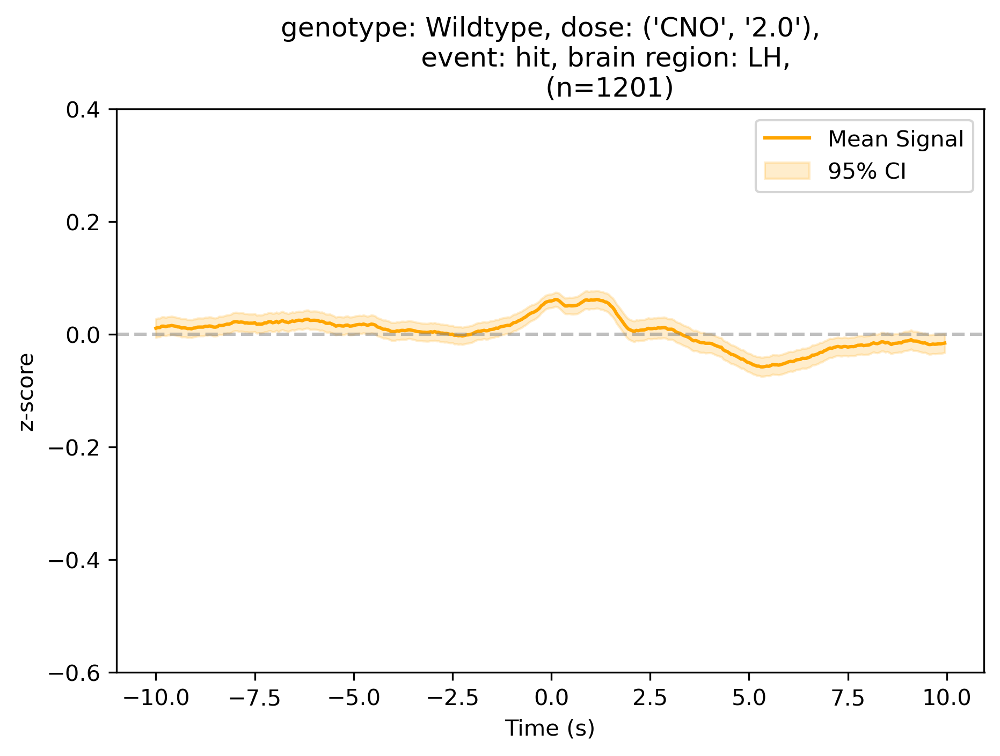

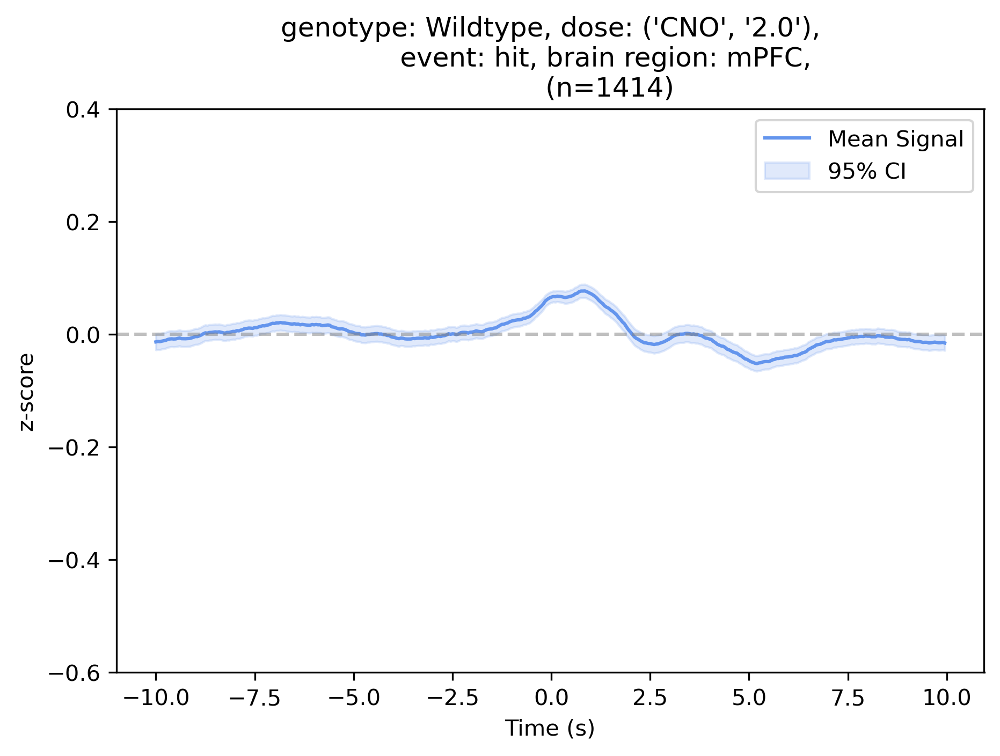

/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:130: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:218: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:175: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:207: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


[WARNING] Invalid ylim (nan, nan) for key: ('TH-Cre', ('CNO', '0.1'), 'hit', 'LH', True). Skipping plot.


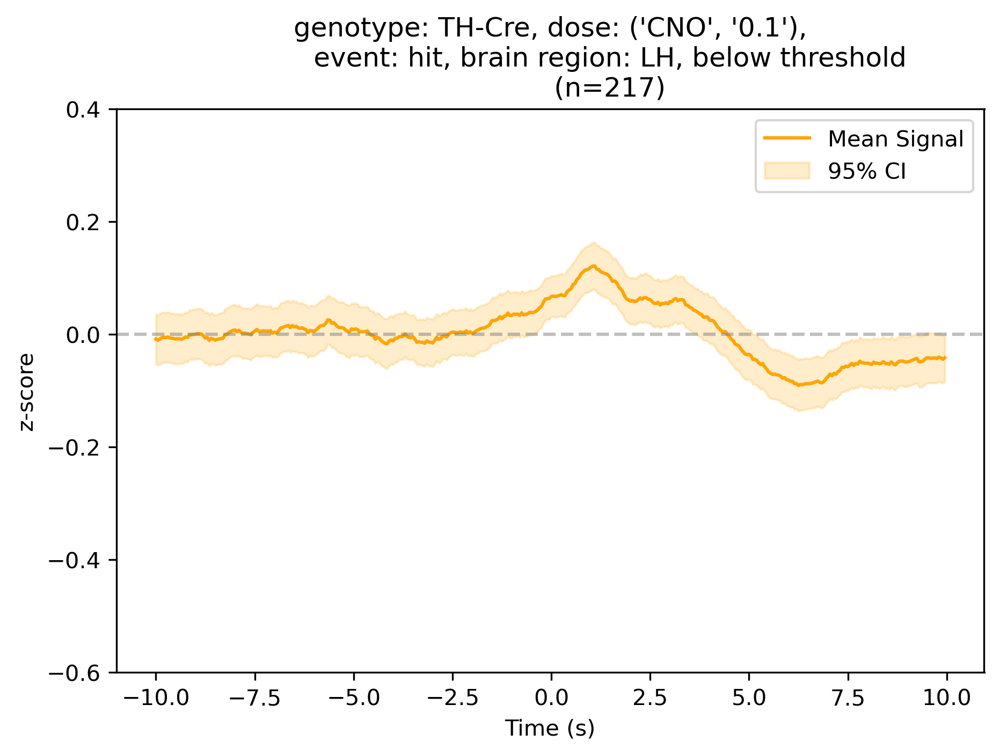

/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:130: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:218: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:175: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/opt/miniconda3/envs/fiberphoto-demo/lib/python3.10/site-packages/numpy/_core/_methods.py:207: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


[WARNING] Invalid ylim (nan, nan) for key: ('TH-Cre', ('CNO', '0.1'), 'hit', 'mPFC', True). Skipping plot.


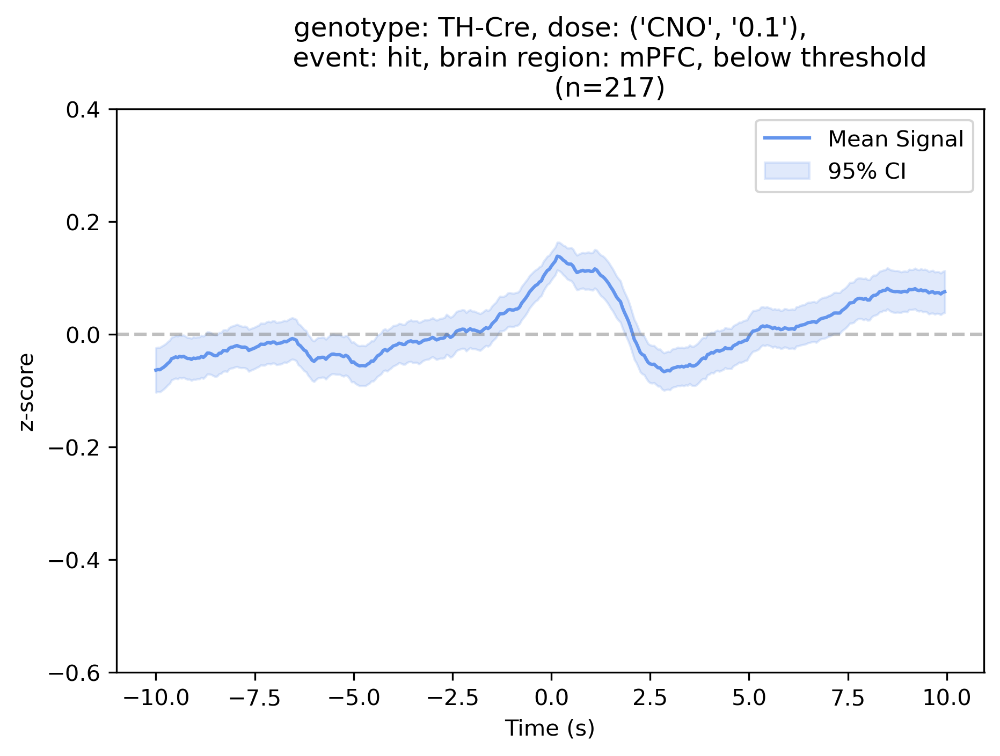

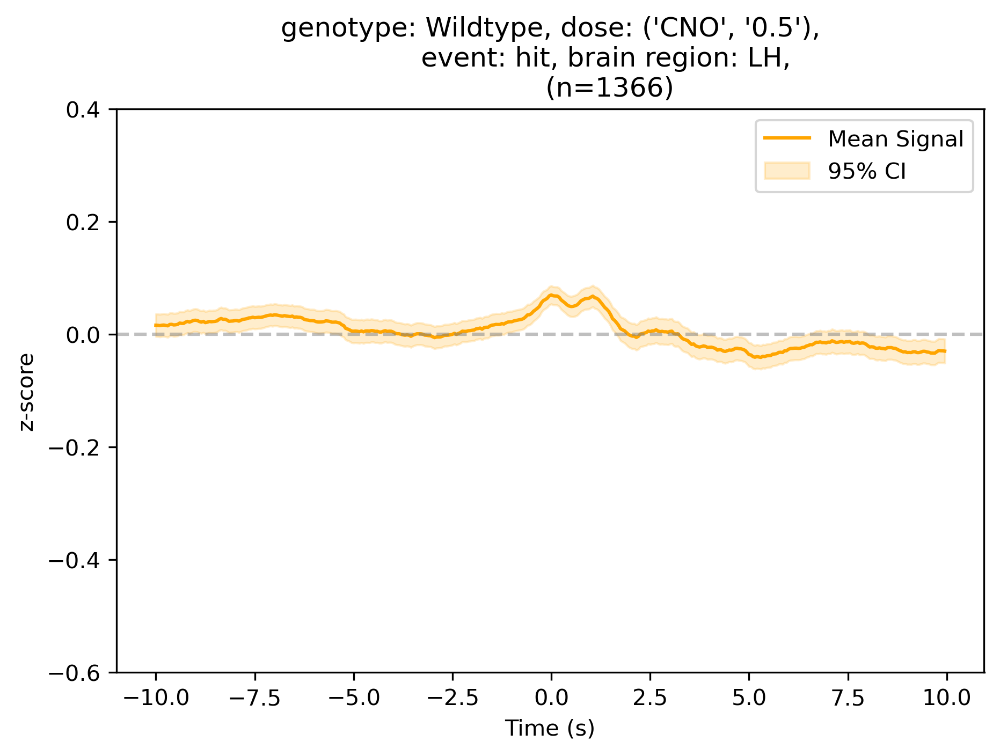

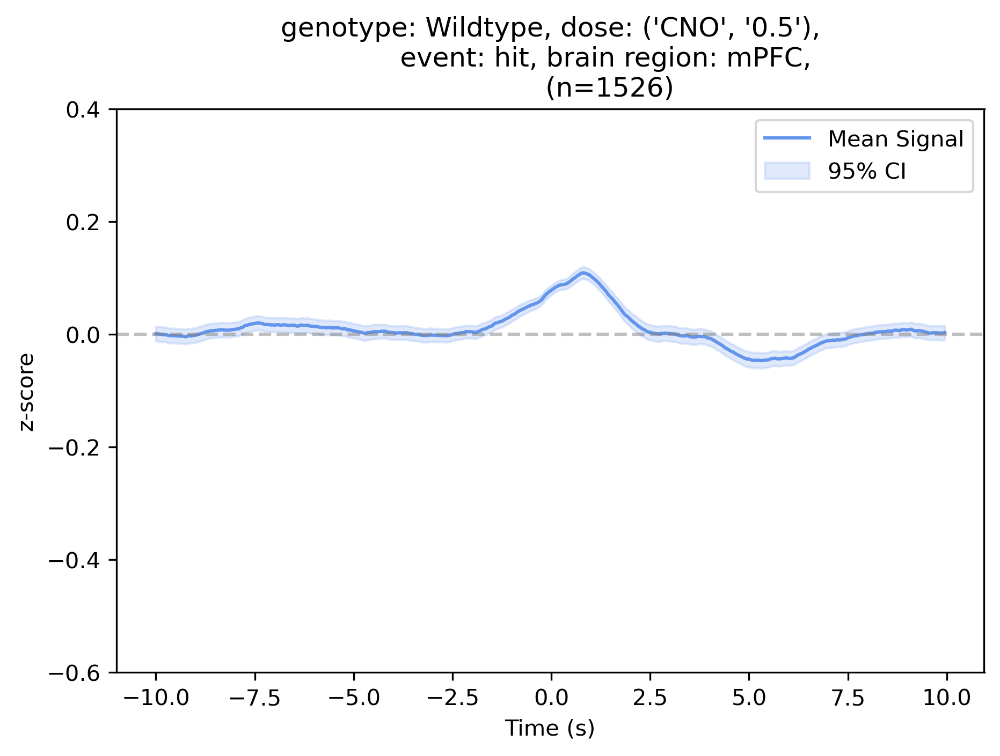

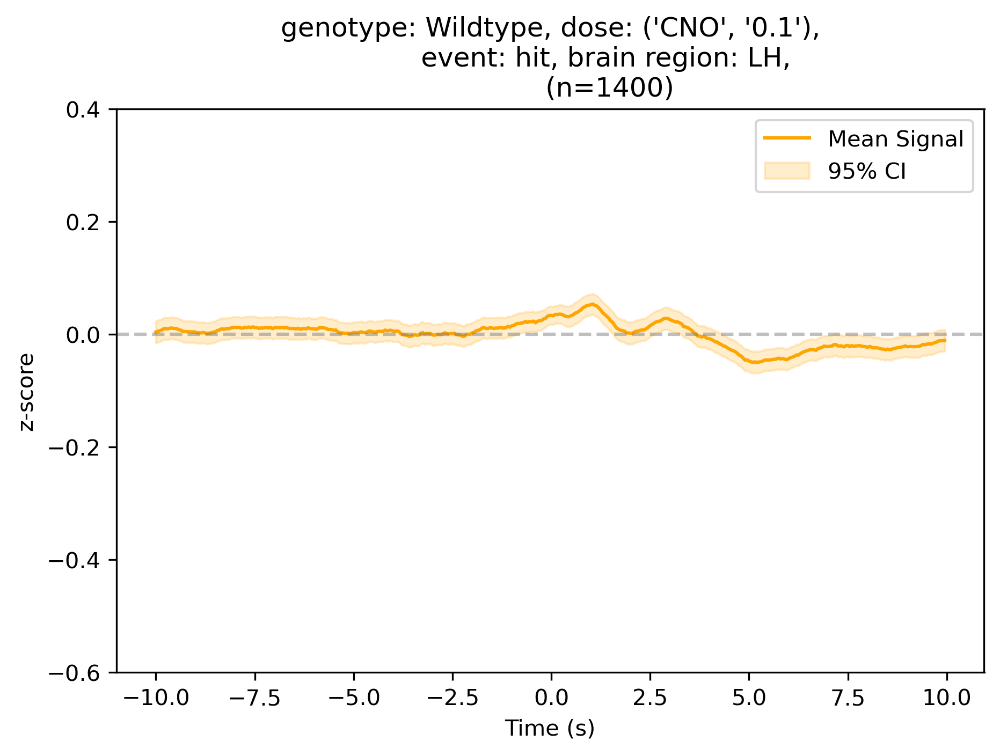

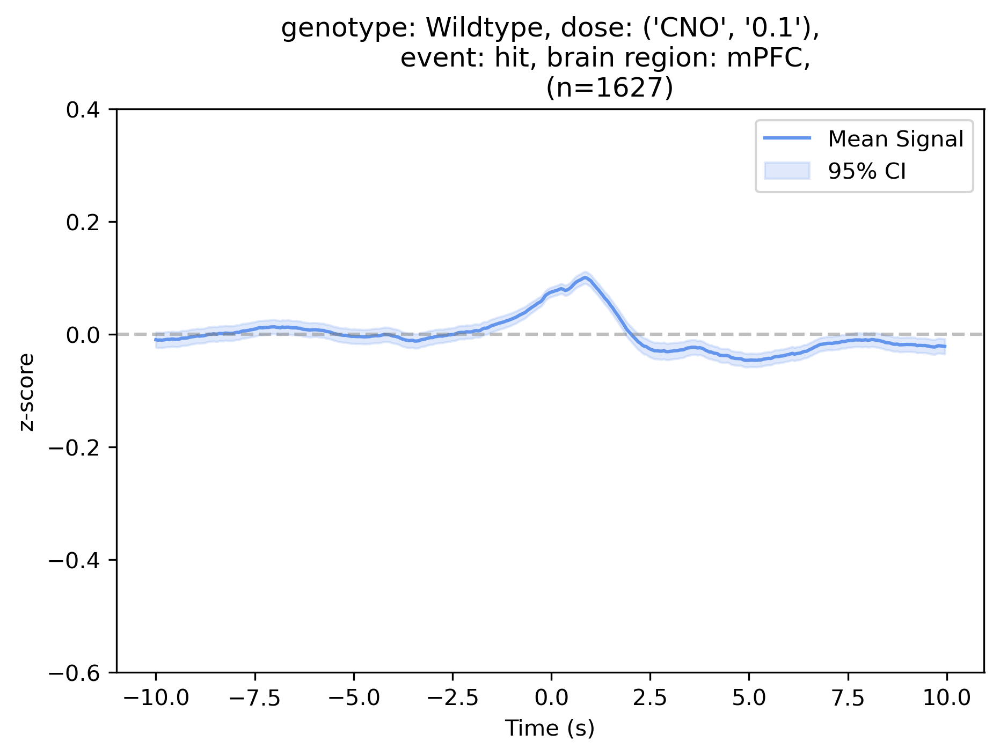

...

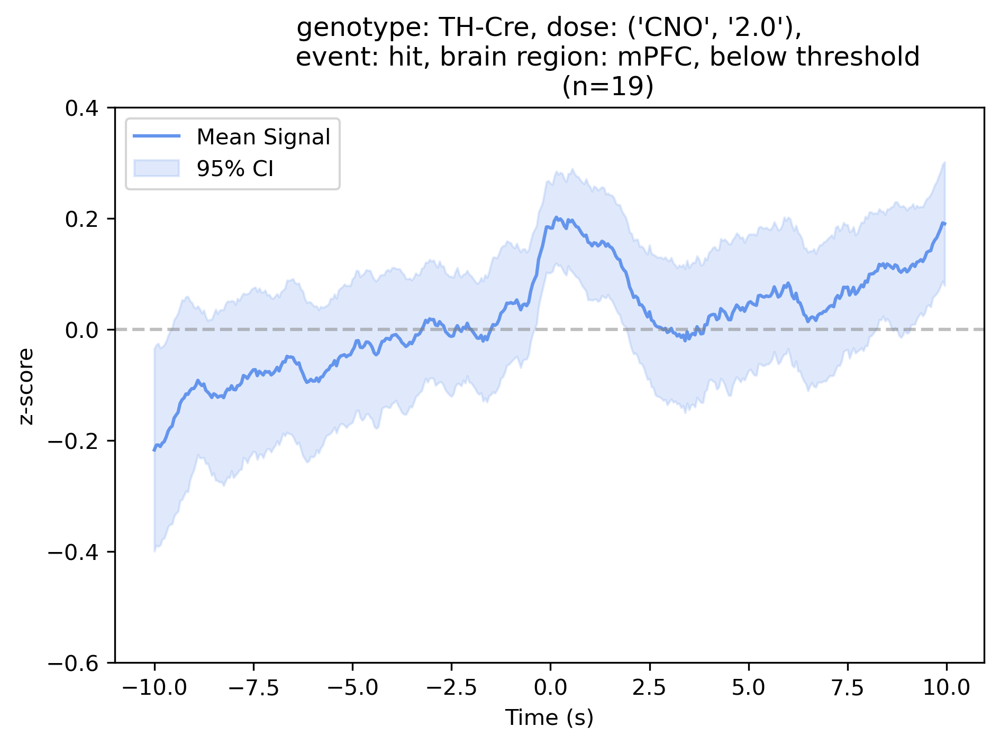

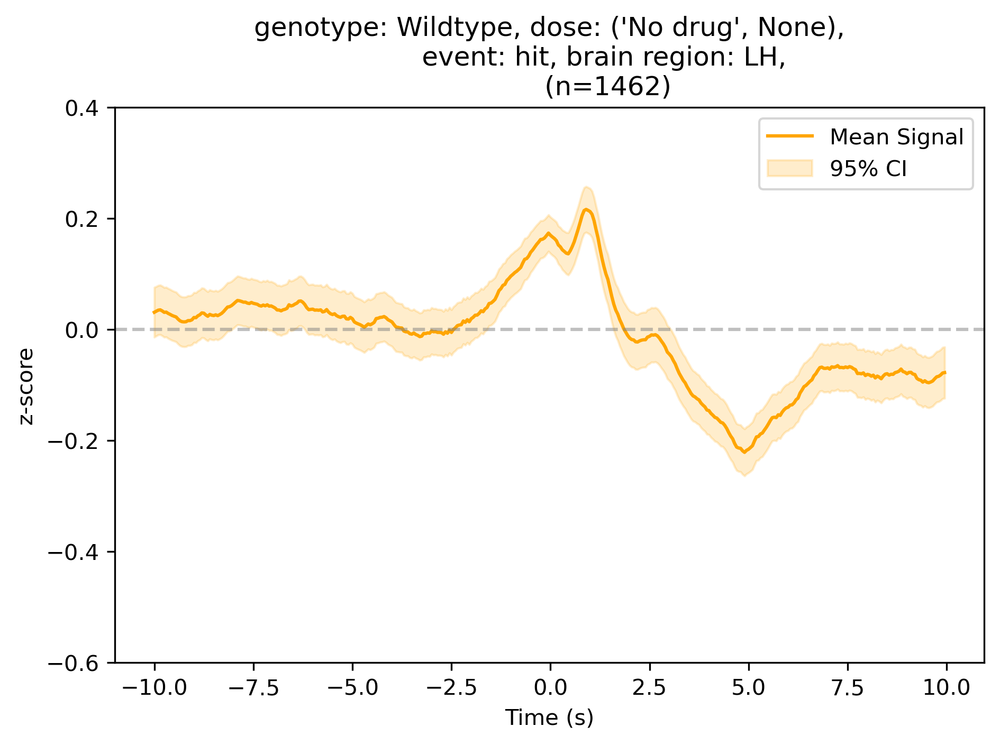

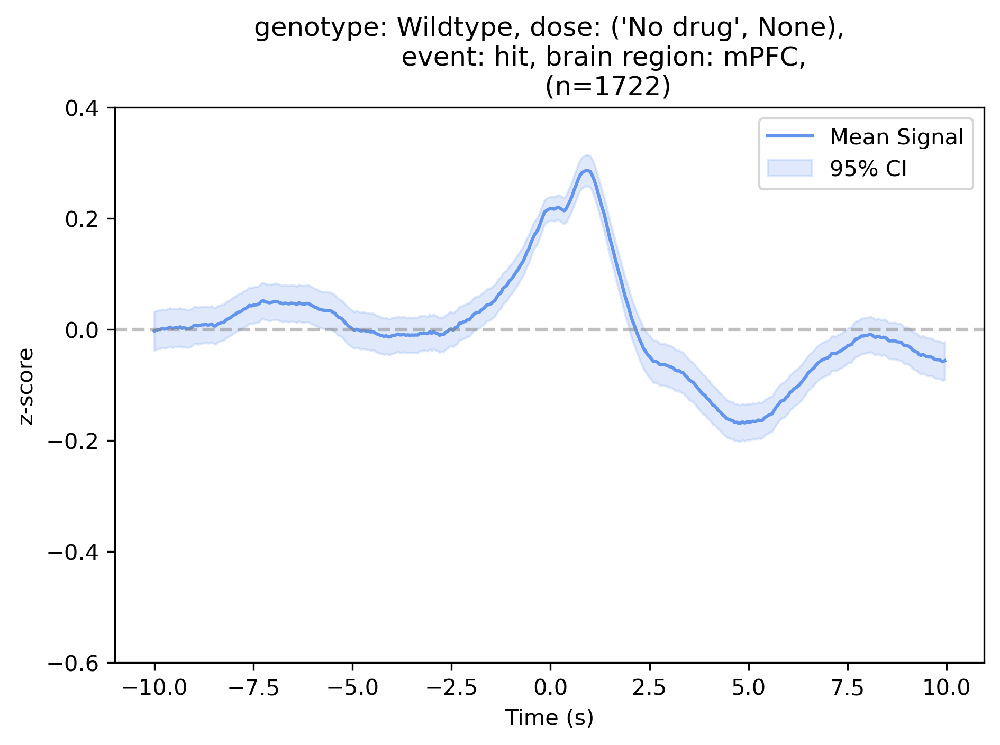

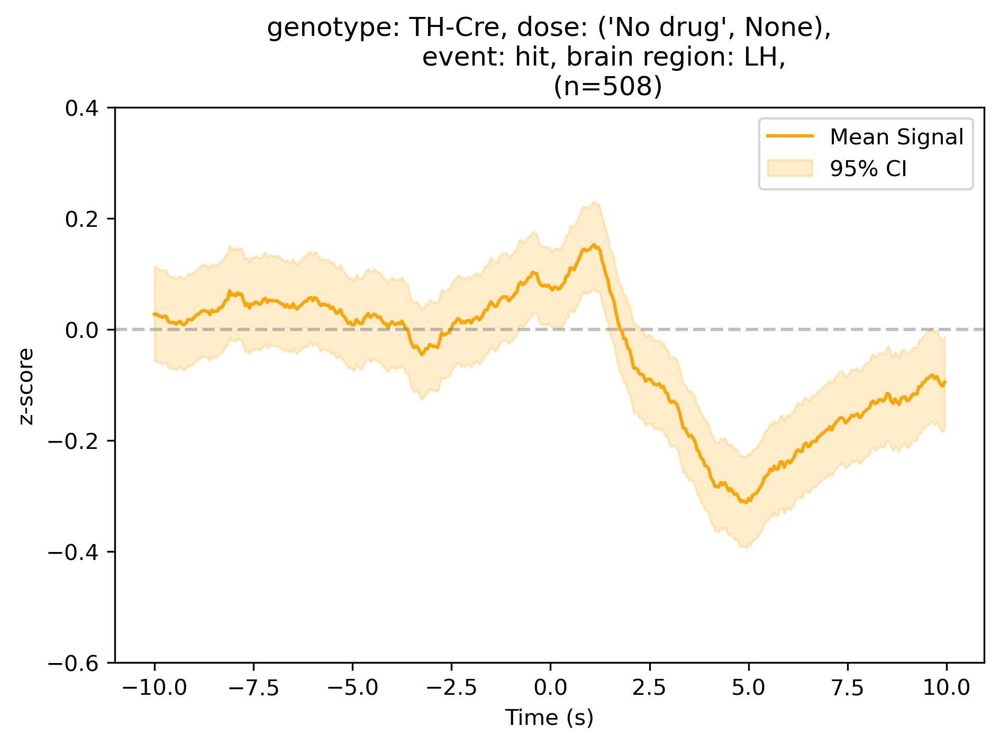

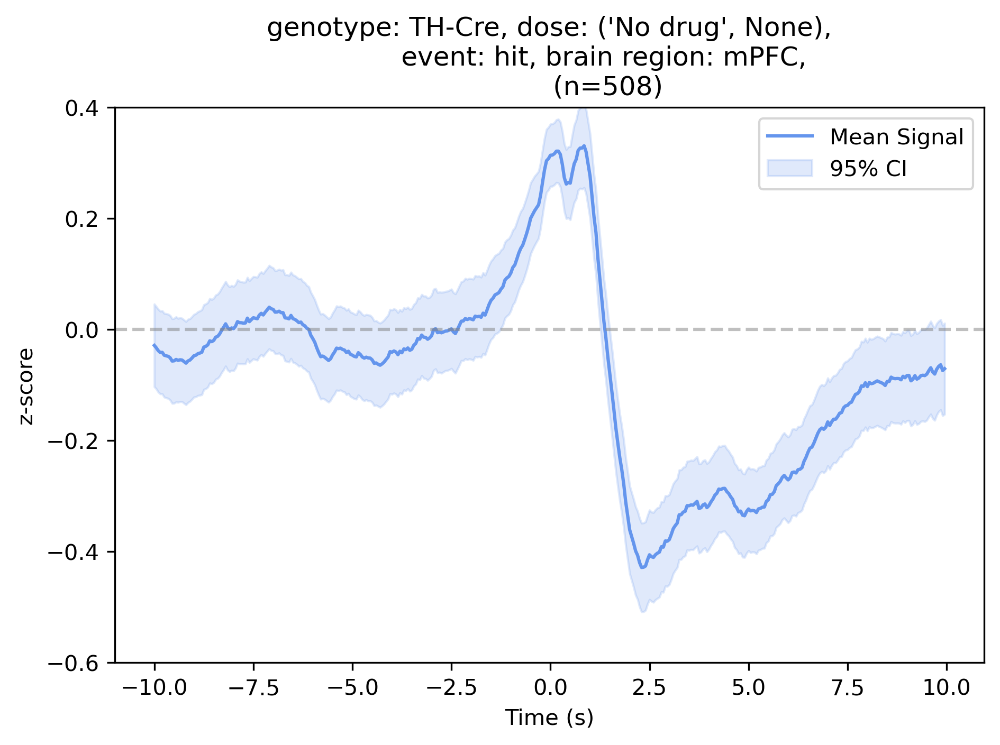

In [72]:
import os
import scipy.stats as stats
# S+ events = [before_dispimg_hit, before_dispimg_miss]
# S- events = [before_dispimg_cor_reject, before_dispimg_mistake]

def preprocess_and_plot_signals(key, dict, smoothing_len=10):
    # Assuming all_signals is predefined
    # signals = all_signals[(event_type, brain_region)]
    signals = dict[key]
    genotype, dose, event, brain_region, is_above_threshold = key

    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['cpt']['fps']
    
    xs = np.arange(-interval_start, interval_end) / fps
    
    # Smooth the mean signal
    # Calculate mean and standard deviation
    ys = np.mean(signals, axis=0)
    std_signal = np.std(signals, axis=0) / np.sqrt(len(signals))

    # Smooth both using a reflection at the boundaries to prevent tapering
    ys = uniform_filter1d(ys, size=smoothing_len, mode='reflect')
    std_signal = uniform_filter1d(std_signal, size=smoothing_len, mode='reflect')

    # Perform baseline correction after smoothing
    pre_mean = ys[143:157].mean()
    ys = ys - pre_mean

    # Use scipy.stats.norm.interval to get the 95% confidence interval
    alpha = 0.95
    ci_lower, ci_upper = stats.norm.interval(alpha, loc=ys, scale=std_signal)

    # The lower and upper bounds
    lb = ci_lower.min()
    ub = ci_upper.max()

    # Check if ylim is valid
    if not np.isfinite(lb) or not np.isfinite(ub) or lb == ub:
        print(f"[WARNING] Invalid ylim ({lb}, {ub}) for key: {key}. Skipping plot.")
        return

    ylim = (lb, ub)
    
    # Assuming brain_reg_to_color is predefined
    color = brain_reg_to_color[brain_region]

    plt.figure(dpi=300)
    plt.plot(xs, ys, color=color, label='Mean Signal')
    plt.fill_between(xs, ci_lower, ci_upper, color=color, alpha=0.2, label='95% CI')
    plt.axhline(0, color='grey', linestyle='--', alpha=0.5)
    
    # if brain_region == 'LH':
    #     plt.ylim(-.3, 0.5)
    # else:
    #     plt.ylim(-0.25, 0.35)
    plt.ylim(ylim)
    if is_above_threshold == True:
        threshold_text = 'above threshold'
    elif is_above_threshold == False:
        threshold_text = 'below threshold' 
    else:
        threshold_text = '' 

    plt.title(f"""genotype: {genotype}, dose: {dose},
              event: {event}, brain region: {brain_region}, {threshold_text}
              (n={len(signals)})""")
    plt.xlabel('Time (s)')
    plt.ylabel('z-score')
    plt.legend()
    #plt.grid()
    
    plt.tight_layout()
    # plt.savefig(f"{genotype}_{dose}_{event}_{brain_region}_{threshold_text}_DREADD_CPT.pdf")
    # Define the folder path
    output_folder = "cpt_events_with_thresholds"

    # if brain_reg_base == 'mPFC':
    #     plt.ylim(-2, 30)
    # else:
    #     plt.ylim(-2, 15)
    plt.ylim(-0.6, 0.4)

    # Create the folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Save the files in the specified folder
    plt.savefig(os.path.join(output_folder, f'{genotype}_{dose}_{event}_{brain_region}_{threshold_text}_77_excluded.png'))
    plt.savefig(os.path.join(output_folder, f'{genotype}_{dose}_{event}_{brain_region}_{threshold_text}_77_excluded.pdf'))
    plt.savefig(os.path.join(output_folder, f'{genotype}_{dose}_{event}_{brain_region}_{threshold_text}_77_excluded.svg'))
    # Save the figure locall
    plt.show()

# Example usage
# Assuming sessions, config, all_signals, brain_reg_to_color are defined
for k in all_signals.keys():
    genotype, dose, event, brain_region, is_above_threshold = k
    if event == 'hit':
        preprocess_and_plot_signals(k, all_signals, smoothing_len=10)

In [64]:
for k, v in {k: np.vstack(v) for k, v in all_signal_groups.items() if k[1] != '77'}.items():
    print(k, v.shape)

('Wildtype', '125', ('Vehicle', None), 'hit', 'LH', None) (115, 400)
('Wildtype', '125', ('Vehicle', None), 'hit', 'mPFC', None) (115, 400)
('Wildtype', '125', ('Vehicle', None), 'mistake', 'LH', None) (71, 400)
('Wildtype', '125', ('Vehicle', None), 'mistake', 'mPFC', None) (71, 400)
('Wildtype', '125', ('Vehicle', None), 'miss', 'LH', None) (405, 400)
('Wildtype', '125', ('Vehicle', None), 'miss', 'mPFC', None) (405, 400)
('Wildtype', '125', ('Vehicle', None), 'cor_reject', 'LH', None) (520, 400)
('Wildtype', '125', ('Vehicle', None), 'cor_reject', 'mPFC', None) (520, 400)
('Wildtype', '125', ('Vehicle', None), 'reward_collect', 'LH', None) (115, 400)
('Wildtype', '125', ('Vehicle', None), 'reward_collect', 'mPFC', None) (115, 400)
('Wildtype', '125', ('Vehicle', None), 'before_dispimg_mistake', 'LH', None) (71, 400)
('Wildtype', '125', ('Vehicle', None), 'S-', 'LH', None) (591, 400)
('Wildtype', '125', ('Vehicle', None), 'before_dispimg_mistake', 'mPFC', None) (71, 400)
('Wildtype',

Generating plots for individual traces...


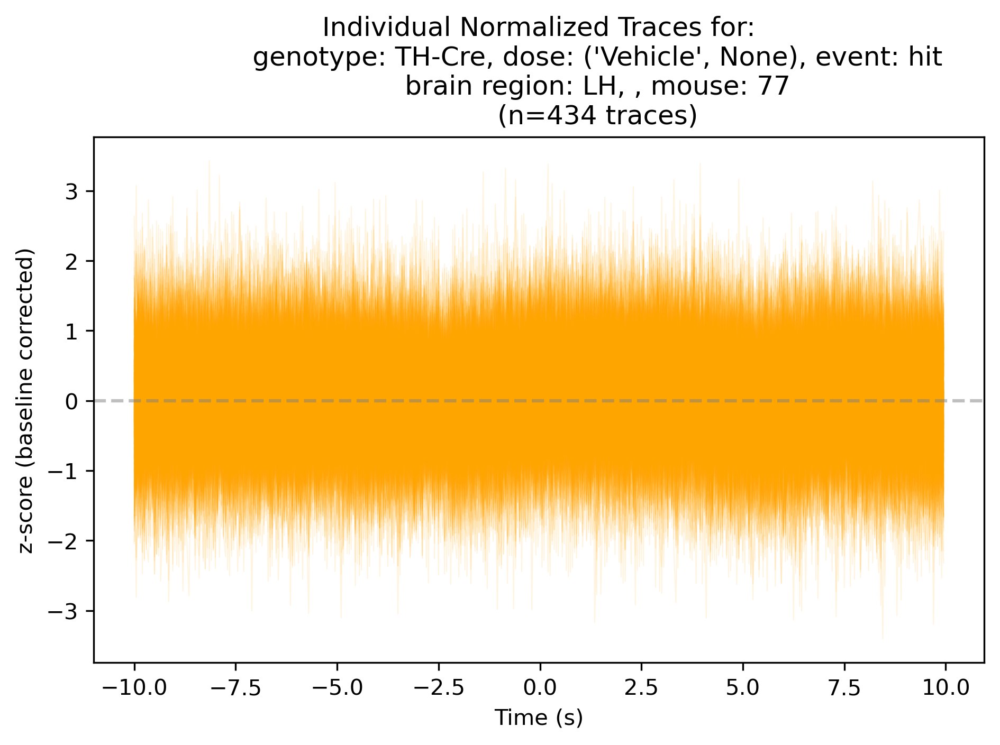

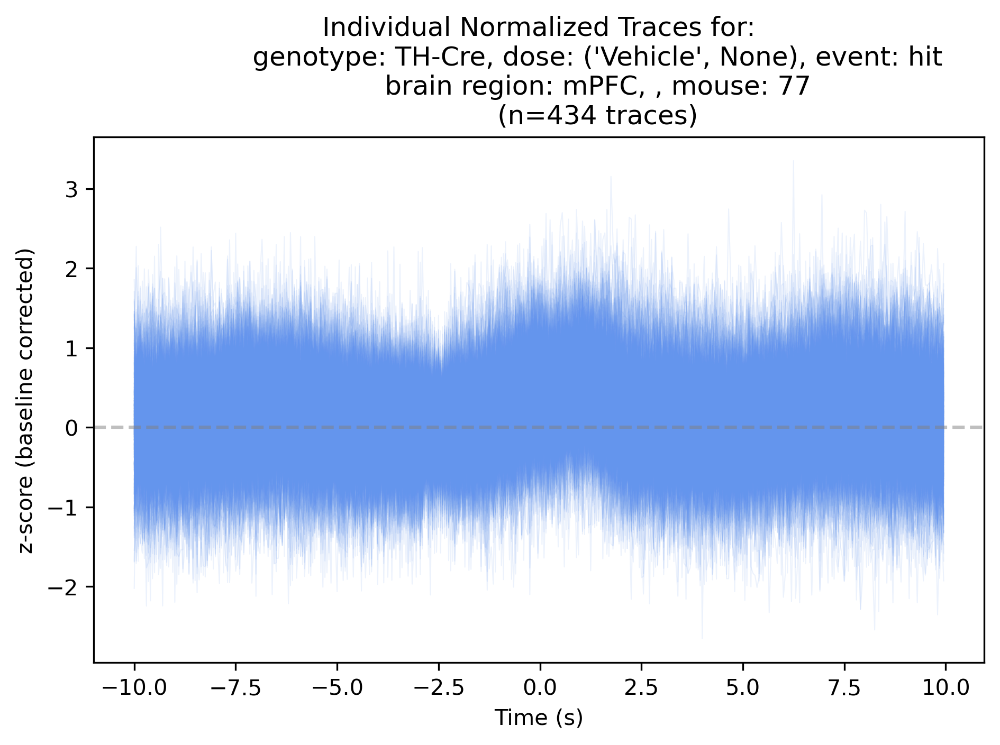

[WARNING] No signals found for key: ('TH-Cre', '77', ('CNO', '0.1'), 'hit', 'LH', True). Skipping plot.


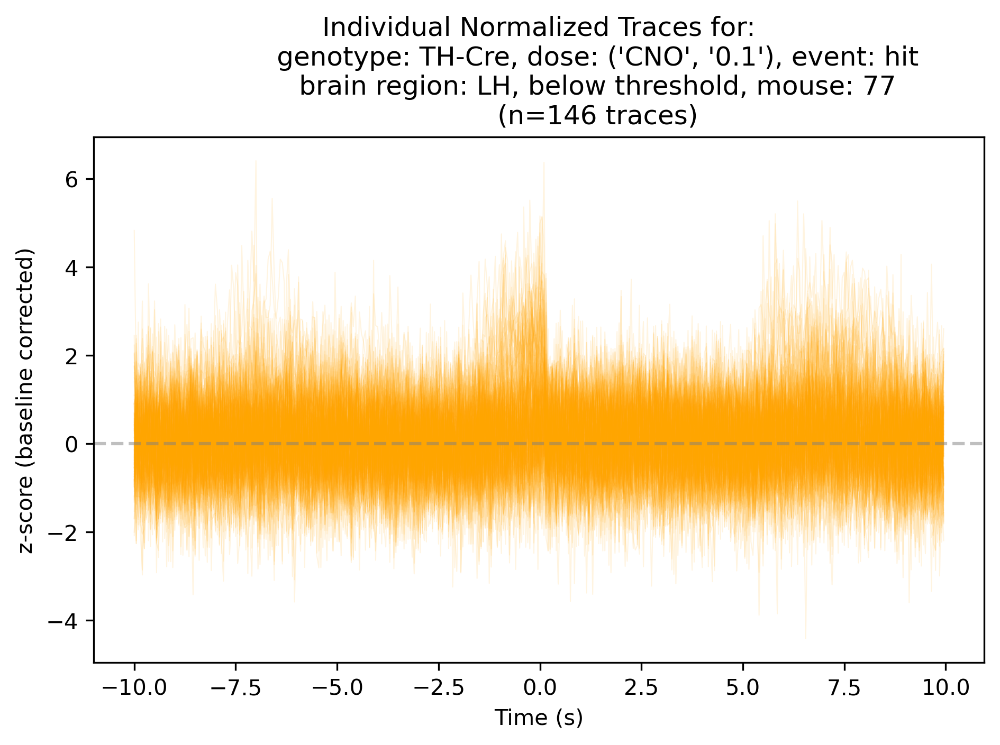

[WARNING] No signals found for key: ('TH-Cre', '77', ('CNO', '0.1'), 'hit', 'mPFC', True). Skipping plot.


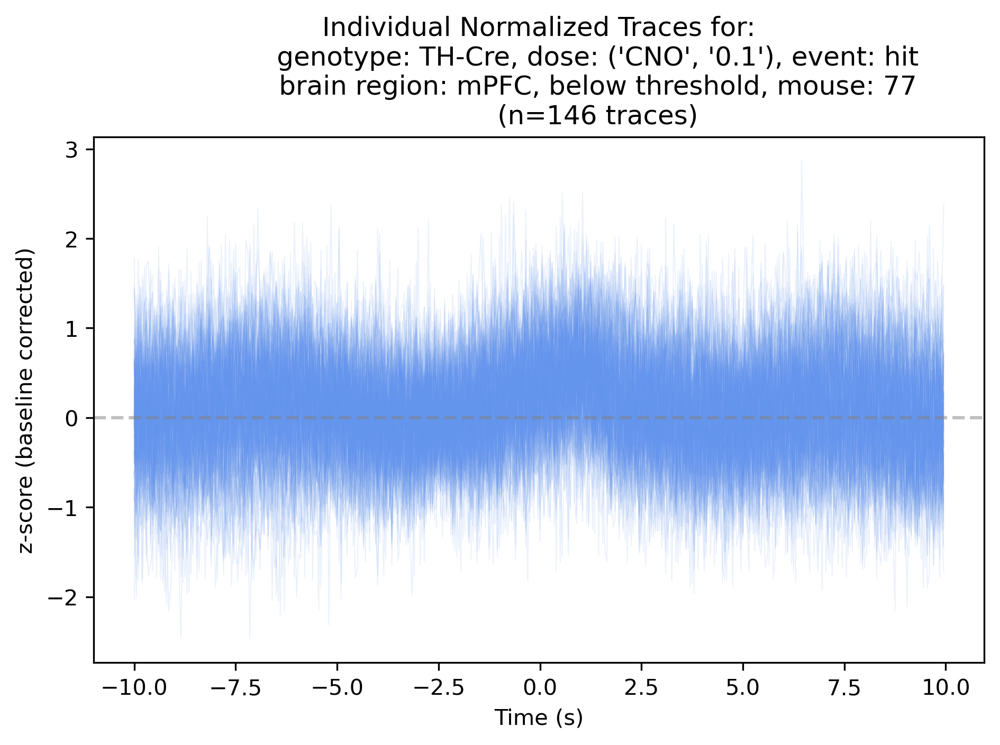

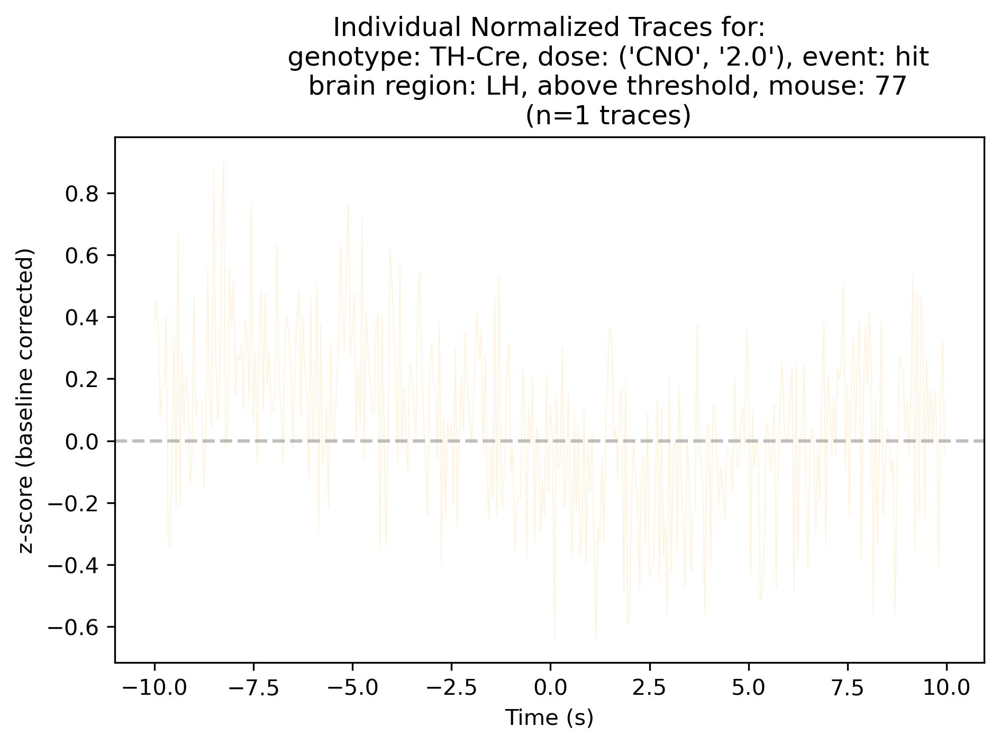

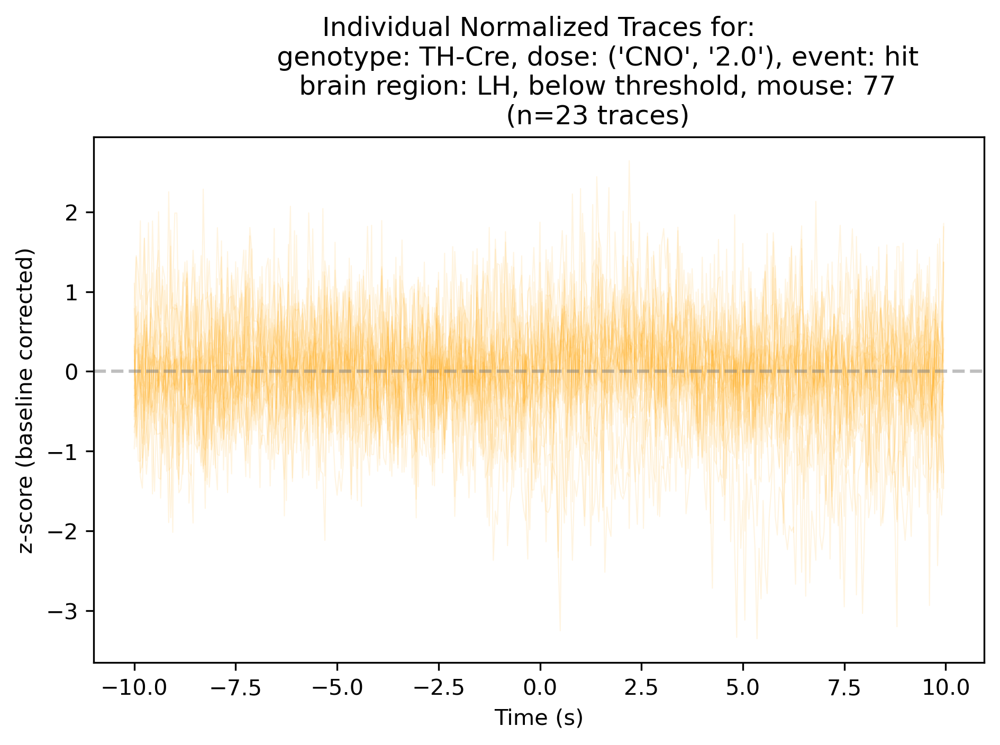

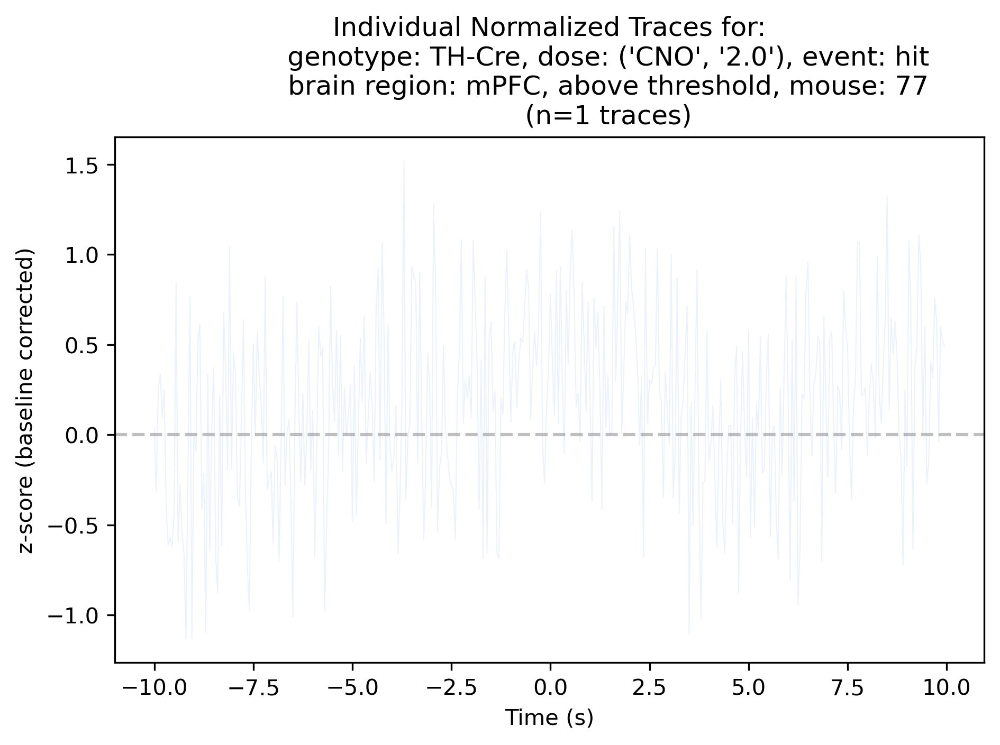

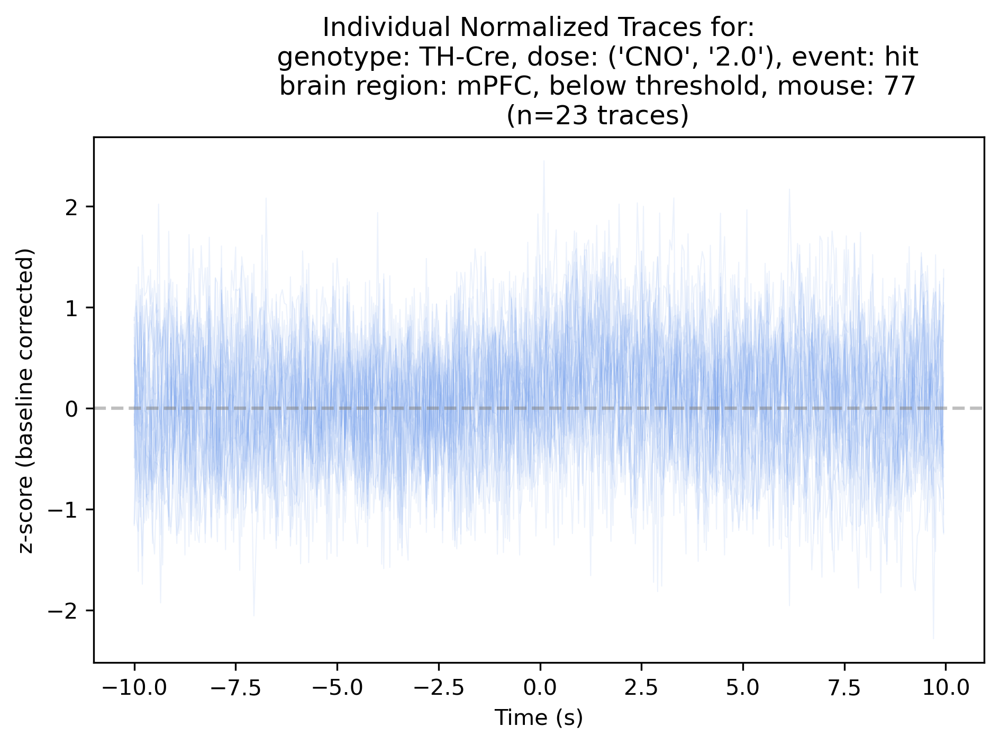

[WARNING] No signals found for key: ('TH-Cre', '77', ('CNO', '0.5'), 'hit', 'LH', True). Skipping plot.


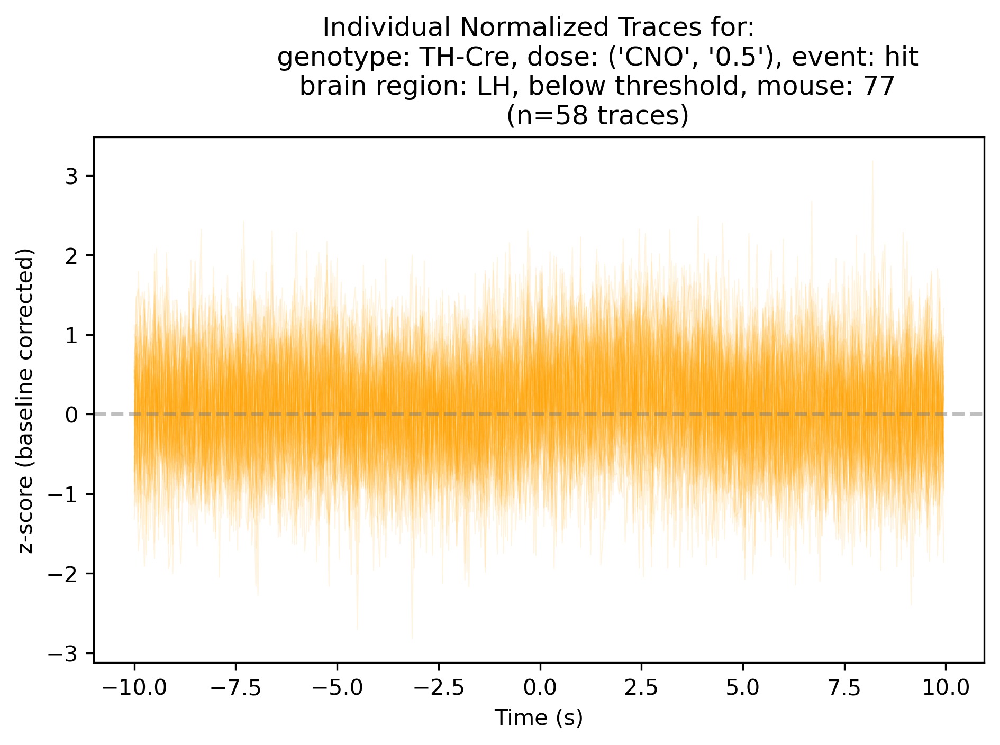

[WARNING] No signals found for key: ('TH-Cre', '77', ('CNO', '0.5'), 'hit', 'mPFC', True). Skipping plot.


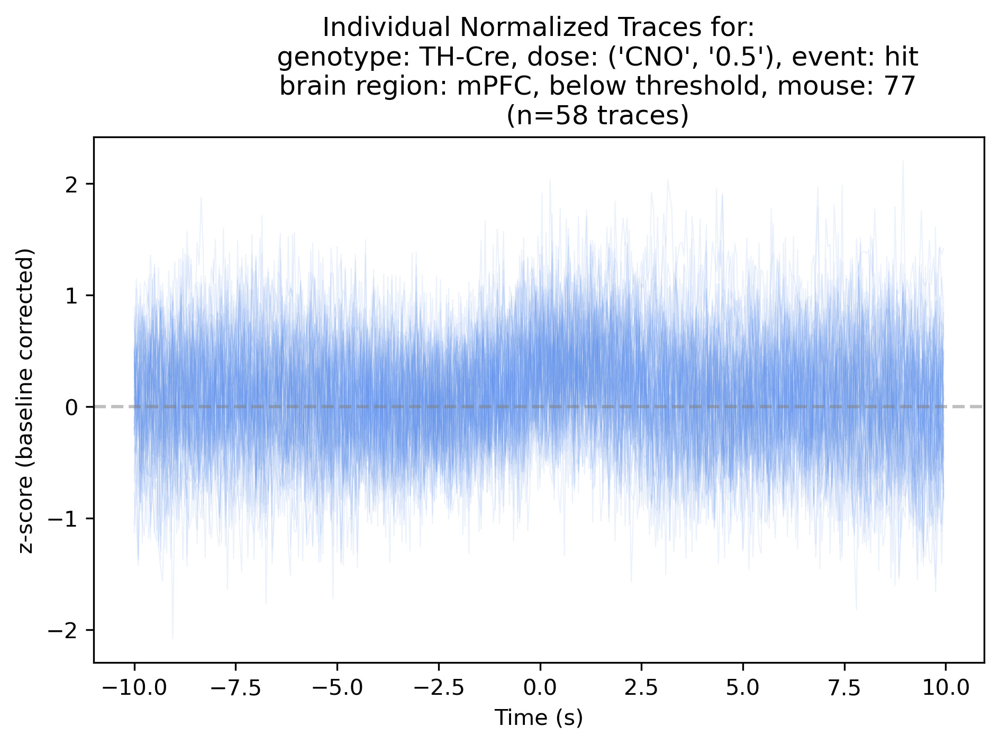

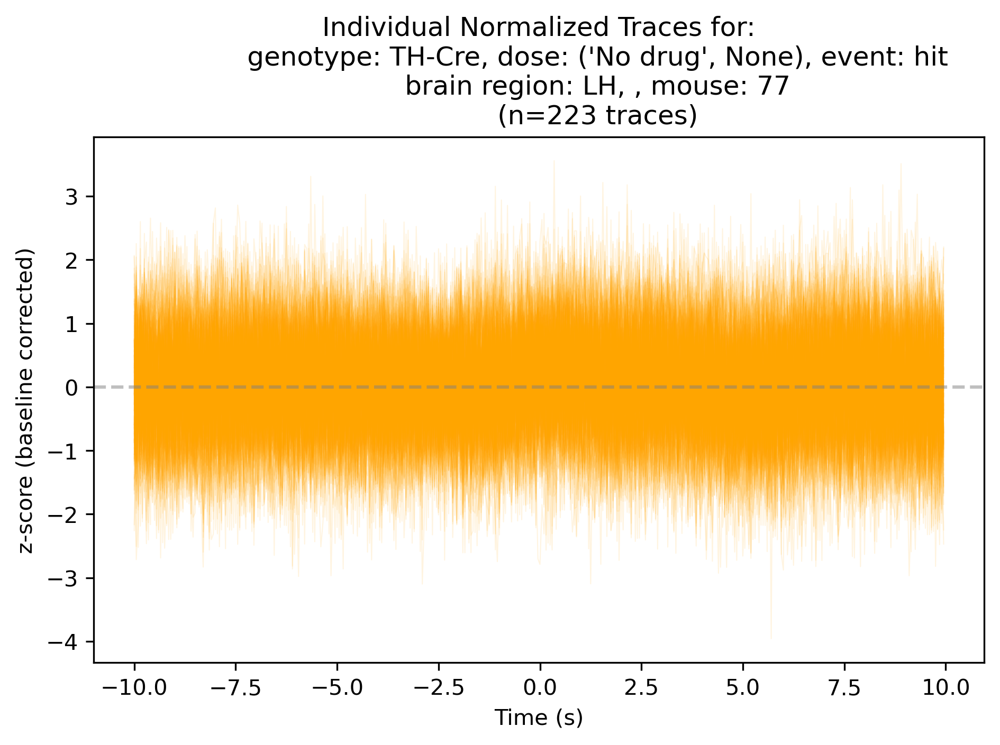

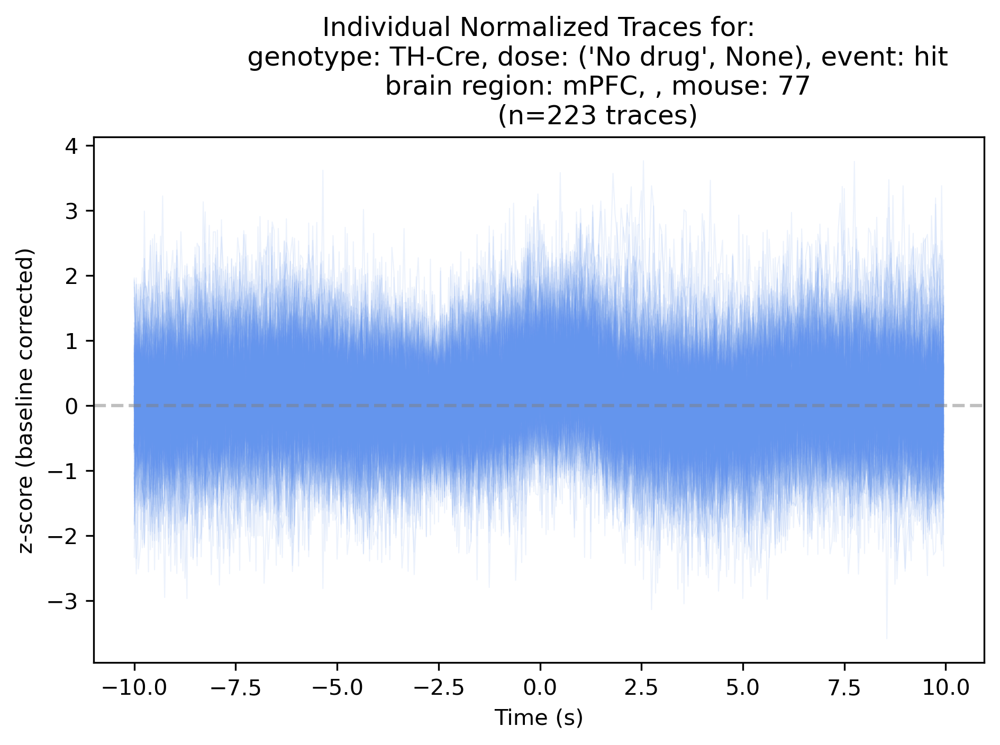

In [59]:
import os
import numpy as np
import matplotlib.pyplot as plt
# S+ events = [before_dispimg_hit, before_dispimg_miss]
# S- events = [before_dispimg_cor_reject, before_dispimg_mistake]

# Assume all necessary variables like config, all_signals, 
# and brain_reg_to_color are already defined in your notebook environment.

def plot_individual_traces(key, data_dict, alpha=0.1, linewidth=0.5):
    """
    Plots all individual signals for a given key on a single plot,
    with each trace normalized to its own pre-event baseline.

    Args:
        key (tuple): The key corresponding to the signals in the dictionary.
        data_dict (dict): The dictionary containing the signal data.
        alpha (float): The transparency level for each trace line.
        linewidth (float): The width of each trace line.
    """
    # Unpack the key for metadata
    genotype, mouse_id, dose, event, brain_region, is_above_threshold = key
    
    # Retrieve the signals from the dictionary
    signals = data_dict.get(key)
    if signals is None or len(signals) == 0:
        print(f"[WARNING] No signals found for key: {key}. Skipping plot.")
        return

    # --- Time Axis Setup ---
    # Assuming 'config' is a predefined configuration object
    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['cpt']['fps']
    xs = np.arange(-interval_start, interval_end) / fps
    
    # --- Plotting Setup ---
    plt.figure(dpi=300)
    
    # Assuming 'brain_reg_to_color' is a predefined dictionary
    color = brain_reg_to_color.get(brain_region, 'blue') # Default to blue if not found

    # --- Plot Each Normalized Trace ---
    # Loop through each individual signal (trace) and plot it with high transparency
    for single_trace in signals:
        # --- Baseline Normalization ---
        # Calculate the mean of the pre-event window for this specific trace
        pre_event_mean = np.mean(single_trace[143:157])
        # Subtract the baseline mean from the entire trace
        normalized_trace = single_trace - pre_event_mean
        
        # Plot the normalized trace
        plt.plot(xs, normalized_trace, color=color, alpha=alpha, linewidth=linewidth)

    # --- Aesthetics and Labels ---
    plt.axhline(0, color='grey', linestyle='--', alpha=0.5)
    
    if is_above_threshold is True:
        threshold_text = 'above threshold'
    elif is_above_threshold is False:
        threshold_text = 'below threshold' 
    else:
        threshold_text = '' 

    plt.title(f"""Individual Normalized Traces for:
              genotype: {genotype}, dose: {dose}, event: {event}
              brain region: {brain_region}, {threshold_text}, mouse: {mouse_id}
              (n={len(signals)} traces)""")
    plt.xlabel('Time (s)')
    plt.ylabel('z-score (baseline corrected)')
    
    # It's often better to let matplotlib auto-scale the y-axis for individual plots,
    # but you can set it manually if needed.
    # plt.ylim(-0.6, 0.4) 

    plt.tight_layout()
    plt.show()

# --- Example Usage ---
# This loop demonstrates how to call the new function.
# It filters for the same conditions as your original example.
print("Generating plots for individual traces...")
for k in all_signals.keys():
    genotype, mouse_id, dose, event, brain_region, is_above_threshold = k
    if mouse_id != '77':
        continue
    if event == 'hit' and genotype == 'TH-Cre':
        plot_individual_traces(k, all_signals, alpha=0.12, linewidth=0.5)

In [19]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

# Assuming config, brain_reg_to_color, all_signals are defined elsewhere

def preprocess_and_plot_signals(key, dict, smoothing_len=10, ylim_dict=None):
    # Assuming all_signals is predefined
    # signals = all_signals[(event_type, brain_region)]
    signals = dict[key]
    genotype, dose, event, brain_region, is_above_threshold = key

    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['cpt']['fps']
    
    xs = np.arange(-interval_start, interval_end) / fps
    
    # Smooth the mean signal
    ys = np.mean(signals, axis=0)
    window = np.ones(smoothing_len) / smoothing_len
    ys = np.convolve(ys, window, 'same')

    # Calculate the standard deviation of the mean
    std_signal = np.std(signals, axis=0) / np.sqrt(len(signals))

    # Use scipy.stats.norm.interval to get the 95% confidence interval
    alpha = 0.95
    ci_lower, ci_upper = stats.norm.interval(alpha, loc=ys, scale=std_signal)

    # The lower and upper bounds
    lb = ci_lower.min()
    ub = ci_upper.max()

    # Check if ylim is valid
    if not np.isfinite(lb) or not np.isfinite(ub) or lb == ub:
        print(f"[WARNING] Invalid ylim ({lb}, {ub}) for key: {key}. Skipping plot.")
        return

    # Use pre-calculated ylim if available
    if ylim_dict and (brain_region, event) in ylim_dict:
        ylim = ylim_dict[(brain_region, event)]
    else:
        ylim = (lb, ub)
    
    # Assuming brain_reg_to_color is predefined
    color = brain_reg_to_color[brain_region]

    plt.figure(dpi=300)
    plt.plot(xs, ys, color=color, label='Mean Signal')
    plt.fill_between(xs, ci_lower, ci_upper, color=color, alpha=0.2, label='95% CI')
    
    plt.ylim(ylim)
    if is_above_threshold == True:
        threshold_text = 'above threshold'
    elif is_above_threshold == False:
        threshold_text = 'below threshold' 
    else:
        threshold_text = '' 

    plt.title(f"""genotype: {genotype}, dose: {dose},
              event: {event}, brain region: {brain_region}, {threshold_text}
              (n={len(signals)})""")
    plt.xlabel('Time (s)')
    plt.ylabel('z-score')
    plt.legend()
    #plt.grid()
    
    plt.tight_layout()
    # Define the folder path
    output_folder = "cpt_events_with_thresholds_synced_ylims"

    # Create the folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Save the files in the specified folder
    # plt.savefig(os.path.join(output_folder, f'{genotype}_{dose}_{event}_{brain_region}_{threshold_text}.png'))
    # plt.savefig(os.path.join(output_folder, f'{genotype}_{dose}_{event}_{brain_region}_{threshold_text}.pdf'))
    # plt.savefig(os.path.join(output_folder, f'{genotype}_{dose}_{event}_{brain_region}_{threshold_text}_comparison.png'))
    # plt.savefig(os.path.join(output_folder, f'{genotype}_{dose}_{event}_{brain_region}_{threshold_text}_comparison.pdf'))
    # Save the figure locall
    plt.show()

# Calculate ylim_dict before the loop
ylim_dict = {}
for key in all_signals.keys():
    signals = all_signals[key]
    _, _, event, brain_region, _ = key

    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['cpt']['fps']

    xs = np.arange(-interval_start, interval_end) / fps

    ys = np.mean(signals, axis=0)
    window = np.ones(10) / 10  # Assuming default smoothing_len=10
    ys = np.convolve(ys, window, 'same')

    std_signal = np.std(signals, axis=0) / np.sqrt(len(signals))
    alpha = 0.95
    ci_lower, ci_upper = stats.norm.interval(alpha, loc=ys, scale=std_signal)
    lb = ci_lower.min()
    ub = ci_upper.max()

    if (brain_region, event) not in ylim_dict:
        ylim_dict[(brain_region, event)] = (lb, ub)
    else:
        min_lb, max_ub = ylim_dict[(brain_region, event)]
        ylim_dict[(brain_region, event)] = (min(min_lb, lb), max(max_ub, ub))

# Example usage
# Assuming sessions, config, all_signals, brain_reg_to_color are defined
for k in all_signals.keys():
    genotype, dose, event, brain_region, is_above_threshold = k
    if is_above_threshold == False and dose[0] == 'Vehicle' and genotype == 'TH-Cre' and brain_region == 'mPFC':
        preprocess_and_plot_signals(k, all_signals, smoothing_len=10, ylim_dict=ylim_dict)
    if is_above_threshold == False and genotype == 'Wildtype':
        preprocess_and_plot_signals(k, all_signals, smoothing_len=10, ylim_dict=ylim_dict)

In [21]:
all_signals.keys()

dict_keys([('Wildtype', ('No drug', None), 'hit', 'LH', None), ('Wildtype', ('No drug', None), 'hit', 'mPFC', None), ('Wildtype', ('No drug', None), 'mistake', 'LH', None), ('Wildtype', ('No drug', None), 'mistake', 'mPFC', None), ('Wildtype', ('No drug', None), 'miss', 'LH', None), ('Wildtype', ('No drug', None), 'miss', 'mPFC', None), ('Wildtype', ('No drug', None), 'cor_reject', 'LH', None), ('Wildtype', ('No drug', None), 'cor_reject', 'mPFC', None), ('Wildtype', ('No drug', None), 'reward_collect', 'LH', None), ('Wildtype', ('No drug', None), 'reward_collect', 'mPFC', None), ('Wildtype', ('No drug', None), 'before_dispimg_mistake', 'LH', None), ('Wildtype', ('No drug', None), 'S-', 'LH', None), ('Wildtype', ('No drug', None), 'before_dispimg_mistake', 'mPFC', None), ('Wildtype', ('No drug', None), 'S-', 'mPFC', None), ('Wildtype', ('No drug', None), 'before_dispimg_hit', 'LH', None), ('Wildtype', ('No drug', None), 'S+', 'LH', None), ('Wildtype', ('No drug', None), 'before_dispimg

In [32]:
# Necessary Imports (ensure these are run)
import matplotlib.pyplot as plt
import numpy as np
import config # Ensure config is imported and accessible
# import scipy.stats as stats # Optional, needed only if using stats.norm.interval

# --- Helper Function to Plot a Single Session (Adapted for Notebook 2) ---
def plot_single_session_trace_nb2(session, target_event, target_region, target_channel, xs, smoothing_len=10, genotype_colors=None):
    """
    Calculates and plots the average trace + CI for a SINGLE session
    in its own figure. Includes Mouse ID, Genotype, and Dose in title.
    Adapted for the structure likely in Notebook 2.

    Args:
        session (object): The session object containing signal_info, genotype, mouse_id etc.
        target_event (str): The event type to plot (e.g., 'hit').
        target_region (str): The brain region to plot (e.g., 'mPFC').
        target_channel (str): The channel key used in signal_info (e.g., 'G').
        xs (np.ndarray): The time axis array.
        smoothing_len (int): Length of the moving average window.
        genotype_colors (dict, optional): Mapping from genotype to color.

    Returns:
        bool: True if a plot was generated, False otherwise.
    """
    # --- Get Session Info ---
    genotype = getattr(session, 'genotype', 'Unknown')
    mouse_id = getattr(session, 'mouse_id', 'UnknownMouse')
    # Create a unique session identifier for titles if session_id isn't directly available
    session_identifier = getattr(session, 'session_id', getattr(session, 'trial_id', f'Mouse_{mouse_id}')) # Use trial_id if session_id missing
    color = genotype_colors.get(genotype, 'gray') if genotype_colors else 'gray'

    # --- Get Drug/Dose Info for Title ---
    dose_info = getattr(session, 'drug_info', {})
    dose_name = dose_info.get('name', 'N/A')
    dose_val = dose_info.get('dose', 'N/A')
    dose_str = f"{dose_name} {dose_val}" if dose_name else "No Drug Info"

    # --- Get Signal Info ---
    # Construct the key using region, channel, and event based on Notebook 2 structure
    signal_key = (target_region, target_channel, target_event)
    curr_signal_info = session.signal_info.get(signal_key)
    if curr_signal_info is None: return False # Skip if no signal info for this key

    signal_matrix = curr_signal_info.get('signal_matrix')
    if signal_matrix is None or not isinstance(signal_matrix, np.ndarray) or signal_matrix.size == 0:
        return False # Skip if no valid matrix

    n_trials = signal_matrix.shape[0]
    if n_trials == 0: return False

    # --- Calculate Mean ---
    ys_mean = np.mean(signal_matrix, axis=0)
    if len(ys_mean) != len(xs):
         print(f"WARNING: Session {session_identifier} length mismatch ({len(ys_mean)} vs {len(xs)}). Skipping plot.")
         return False

    # --- Calculate CI (approximate using SEM * 1.96) ---
    ci_lower, ci_upper = ys_mean, ys_mean # Default
    ci_calculated = False
    if n_trials >= 2:
        ys_sem = np.std(signal_matrix, axis=0, ddof=1) / np.sqrt(n_trials)
        ys_sem = np.nan_to_num(ys_sem, nan=0.0, posinf=0.0, neginf=0.0)
        if not np.all(np.isclose(ys_sem * 1.96, 0, atol=1e-8)):
            ci_lower = ys_mean - 1.96 * ys_sem
            ci_upper = ys_mean + 1.96 * ys_sem
            ci_calculated = True

    # --- Smoothing (apply to mean for line plot) ---
    window = np.ones(smoothing_len) / smoothing_len
    ys_smooth = ys_mean
    if len(ys_mean) >= smoothing_len:
        ys_smooth = np.convolve(ys_mean, window, 'same')

    # --- Plotting ---
    plt.figure(dpi=150, figsize=(8, 5)) # New figure for each session

    # Plot CI region first
    if ci_calculated:
        plt.fill_between(xs, ci_lower, ci_upper, color=color, alpha=0.2, linewidth=0, label='95% CI (approx.)')

    # Plot smoothed mean line
    plt.plot(xs, ys_smooth, color=color, linewidth=1.2, label=f'Mean (n={n_trials} trials)')

    # Create title including Mouse ID, Genotype, and Dose
    title = f"Mouse: {mouse_id} ({genotype}) - Session: {session_identifier}\n" \
            f"Event: {target_event}, Region: {target_region}, Dose: {dose_str}"
    plt.title(title)
    plt.xlabel('Time relative to event (s)')
    plt.ylabel('z-score')
    plt.ylim(-0.8, 0.8)
    plt.axhline(0, color='grey', linestyle='--', linewidth=0.7)
    plt.axvline(0, color='grey', linestyle='--', linewidth=0.7)
    plt.grid(True, which='both', linestyle=':', linewidth=0.5)
    plt.legend(loc='upper right')
    plt.tight_layout()

    plt.savefig(f"cno_stuff_post_{mouse_id}_{genotype}_sim_yscale.pdf")
    plt.savefig(f"cno_stuff_post_{mouse_id}_{genotype}_sim_yscale.png")
    plt.show() # Show plot immediately

    return True # Indicate plot was generated


--- Generating Individual Plot Per Session (Notebook 2 Data) ---
Target Event: 'hit', Target Region: 'mPFC', Channel: 'G'
Time axis generated: -10.00s to 10.00s (400 points)
Processing 166 sessions...


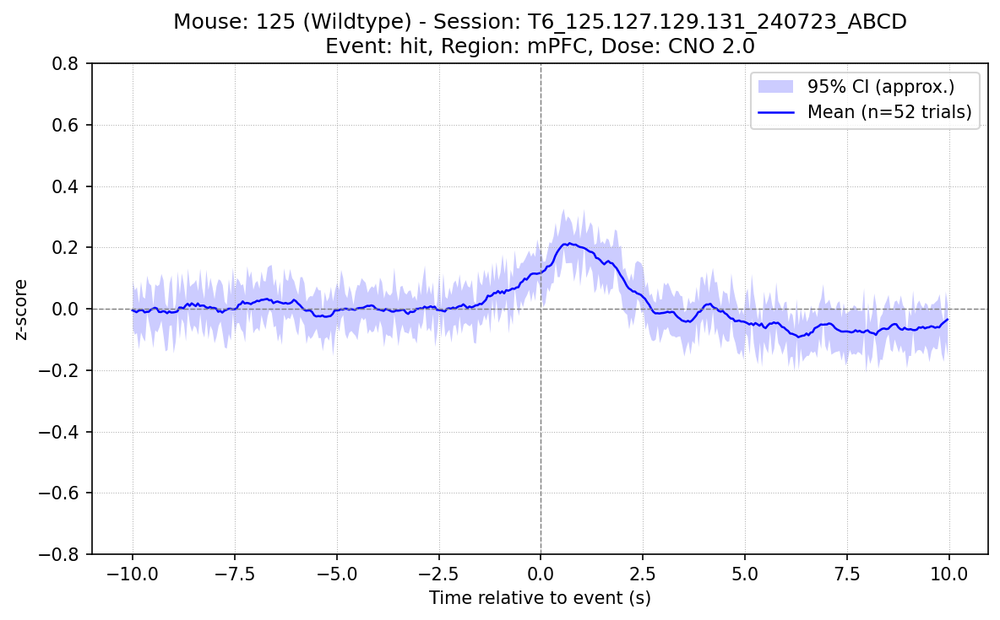

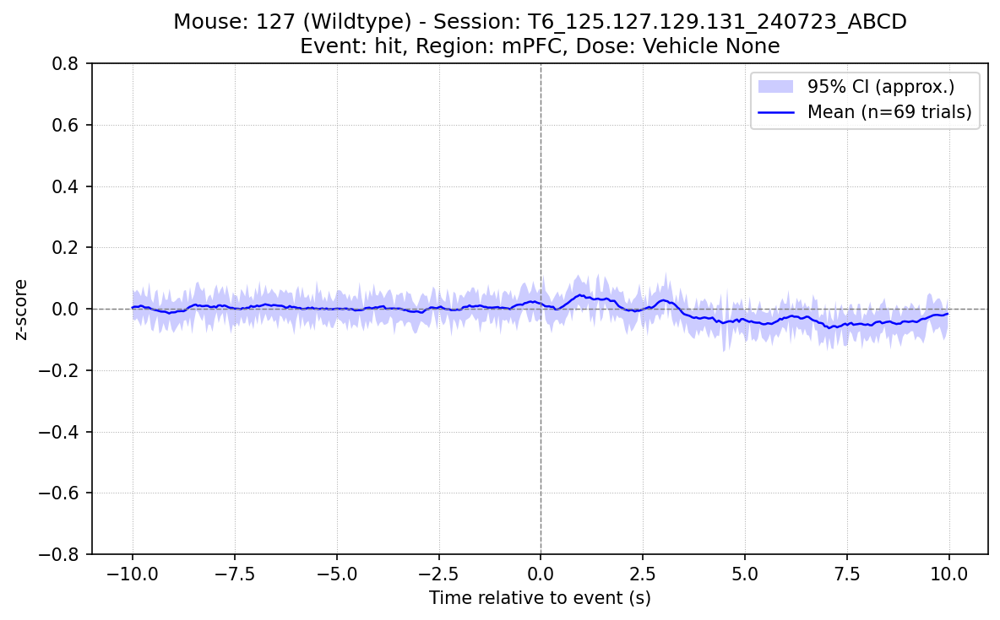

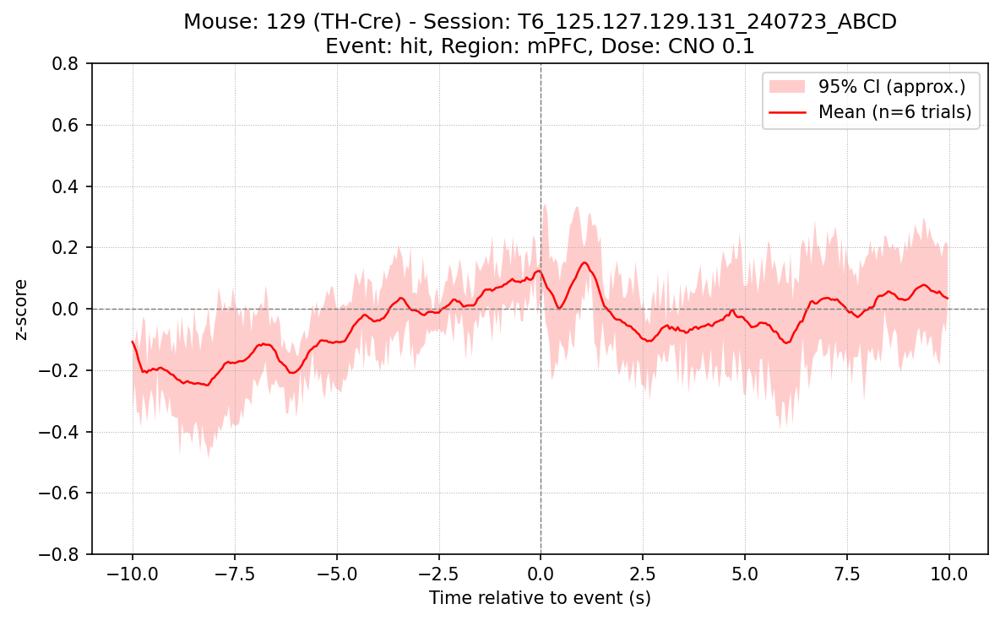

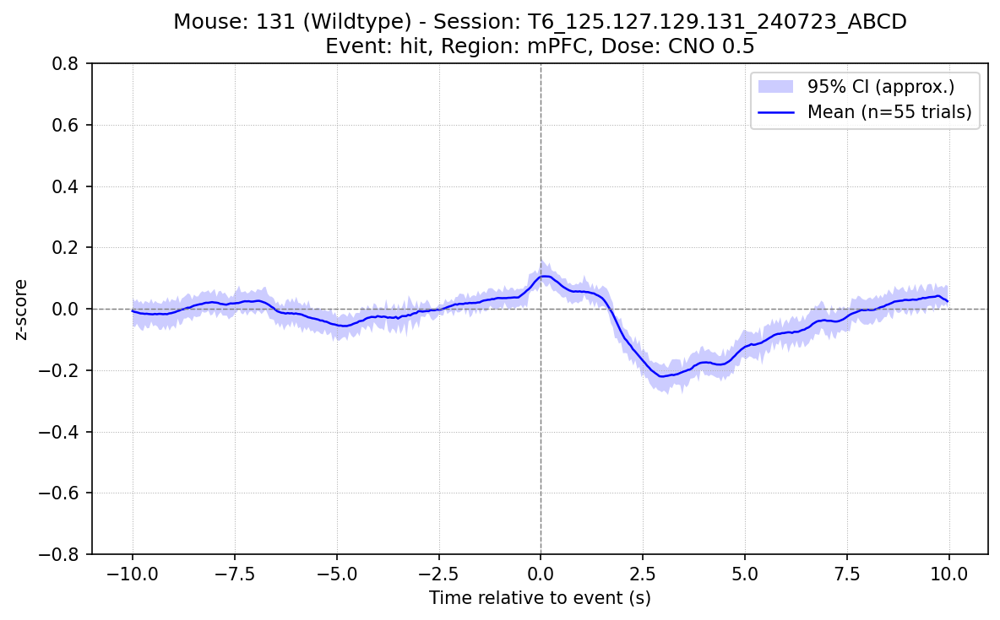

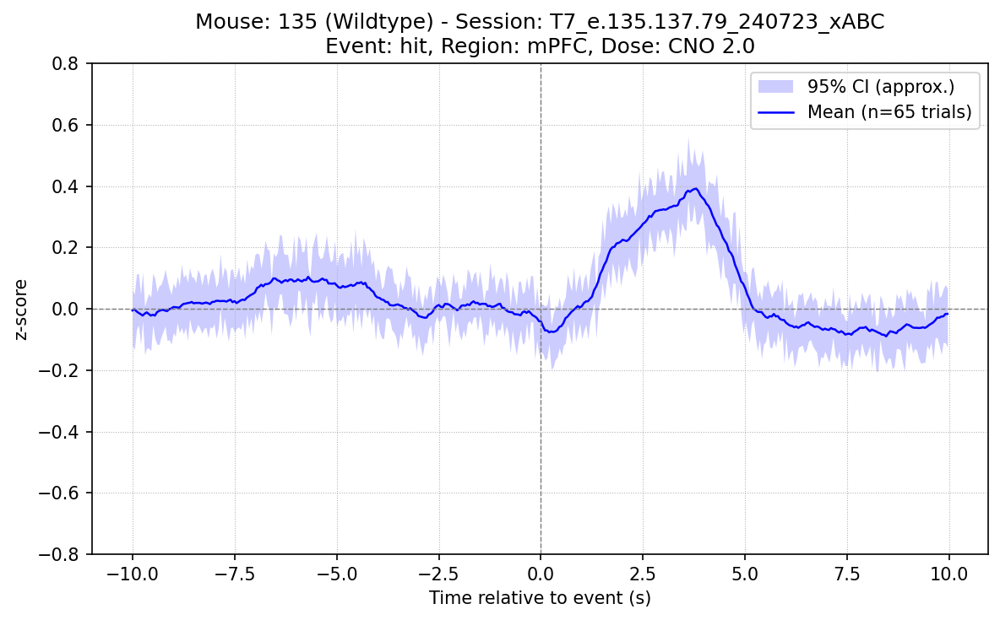

...

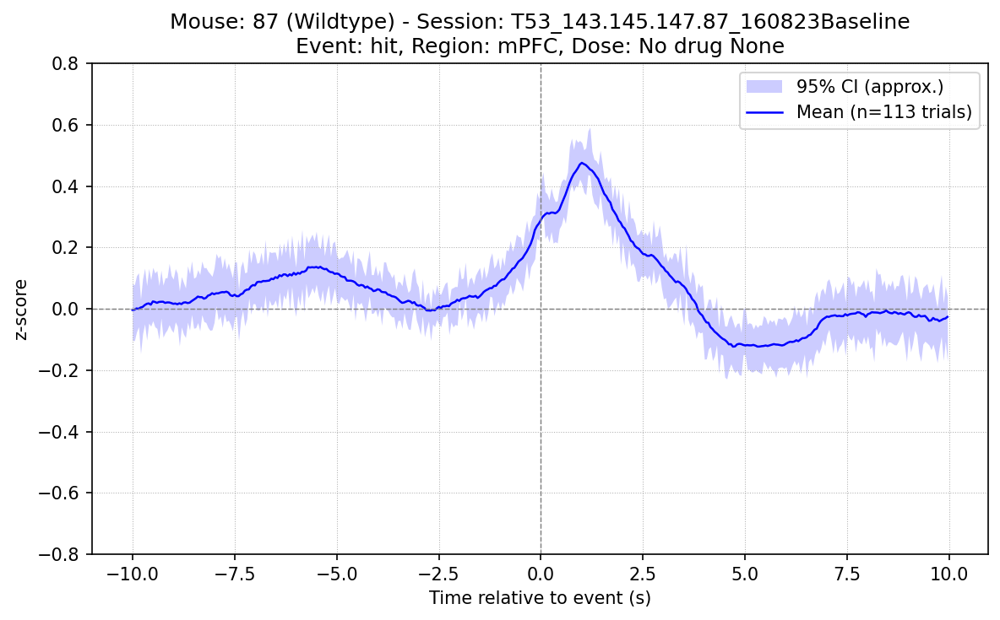

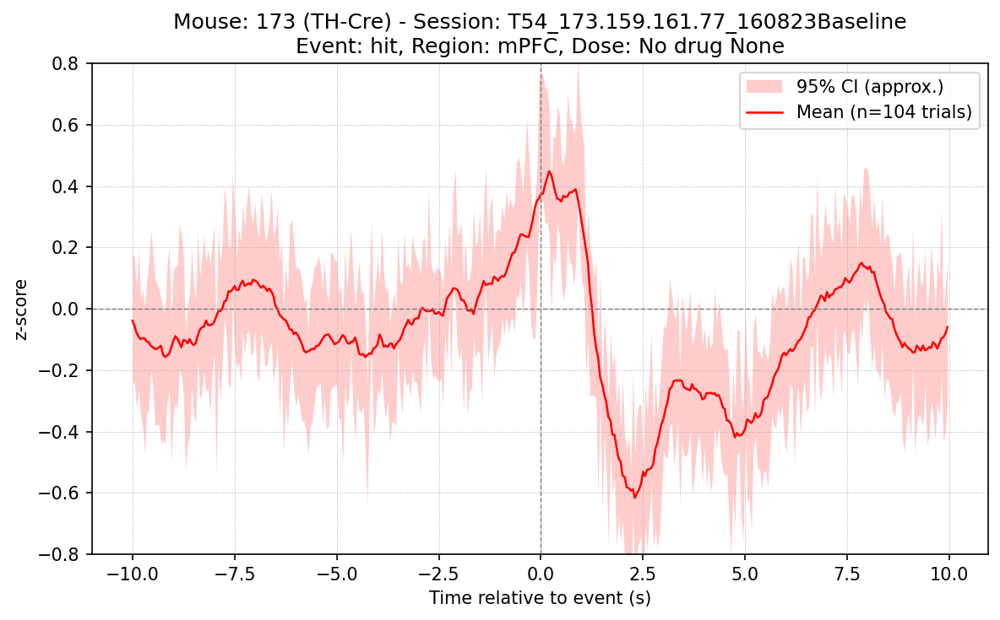

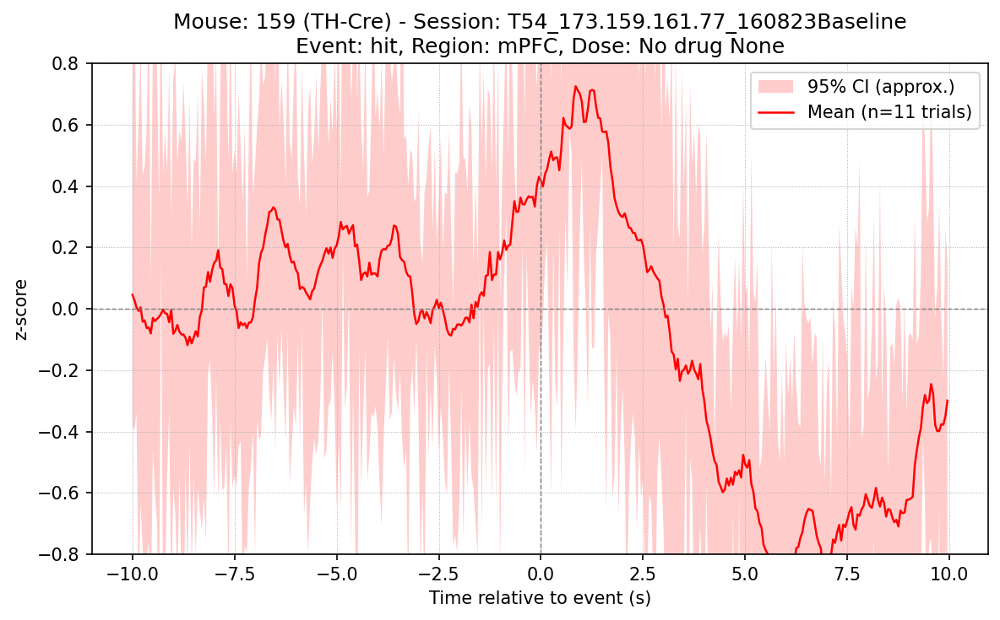

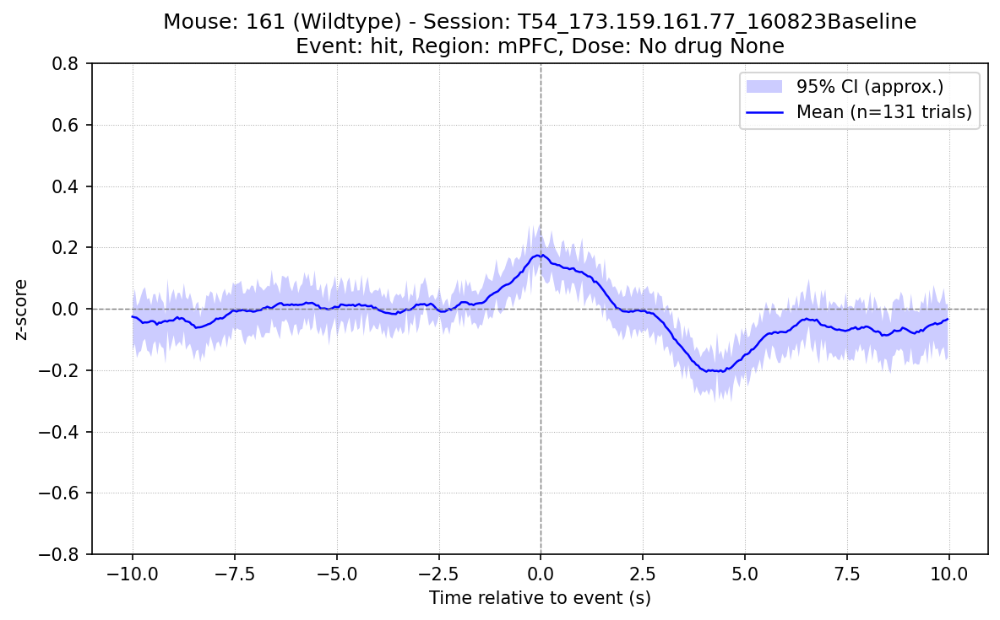

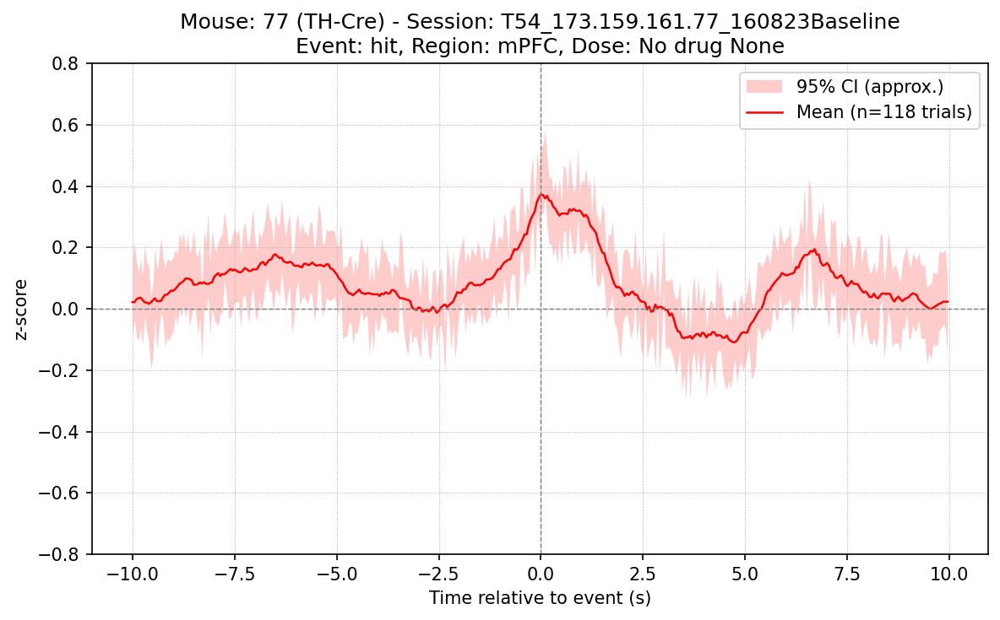


Generated 160 individual session plots.


In [33]:
# --- Define Parameters and Execute Plotting ---

# Define target parameters for the plots
plot_target_event = 'hit'      # !!! REPLACE with your actual event key if different (e.g., 'before_dispimg_hit'?)
plot_target_region = 'mPFC'    # !!! REPLACE with your actual region key if different
plot_target_channel = 'G'      # !!! VERIFY this is the correct channel key used in signal_info
smoothing_len_single = 10      # Adjust smoothing if desired

# Ensure genotype_colors is defined
genotype_colors = {'Wildtype': 'blue', 'TH-Cre': 'red'}

print(f"\n--- Generating Individual Plot Per Session (Notebook 2 Data) ---")
print(f"Target Event: '{plot_target_event}', Target Region: '{plot_target_region}', Channel: '{plot_target_channel}'")

# --- Calculate time axis (xs) once ---
try:
    # Ensure correct path to config parameters for Notebook 2 if different
    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['cpt']['fps']
    xs_single = np.arange(-interval_start, interval_end) / fps
    print(f"Time axis generated: {-interval_start/fps:.2f}s to {interval_end/fps:.2f}s ({len(xs_single)} points)")
except Exception as e:
    print(f"ERROR: Could not get plotting parameters from config: {e}. Cannot generate plots.")
    xs_single = None # Ensure xs_single is None if calculation fails

# --- Loop through the 'sessions' list and plot ---
# IMPORTANT: This assumes 'sessions' is the list of session objects
#            AFTER loading, genotype updates, and filtering by session_skips.
plots_generated_count = 0
if xs_single is not None:
    if 'sessions' in locals() and isinstance(sessions, list):
        print(f"Processing {len(sessions)} sessions...")
        for session_obj in sessions:
            # Call the helper function for each session
            plotted = plot_single_session_trace_nb2( # Use the NB2 version of the function
                session=session_obj,
                target_event=plot_target_event,
                target_region=plot_target_region,
                target_channel=plot_target_channel, # Pass channel
                xs=xs_single,
                smoothing_len=smoothing_len_single,
                genotype_colors=genotype_colors
            )
            if plotted:
                plots_generated_count += 1
        print(f"\nGenerated {plots_generated_count} individual session plots.")
    else:
        print("ERROR: 'sessions' list not found or is not a list. Cannot generate plots.")
else:
    print("\nPlot generation skipped due to configuration error (time axis).")

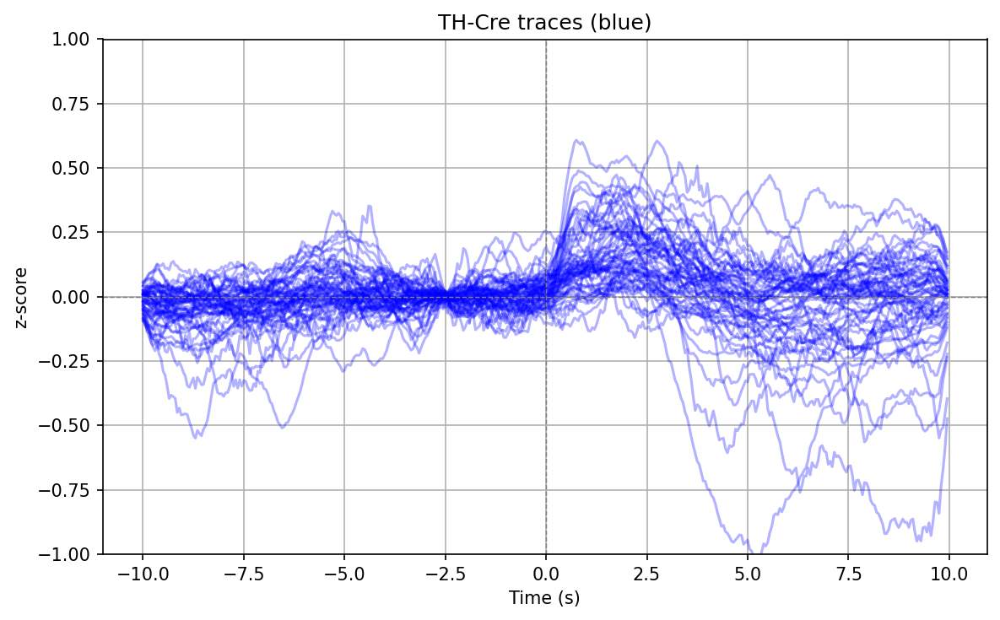

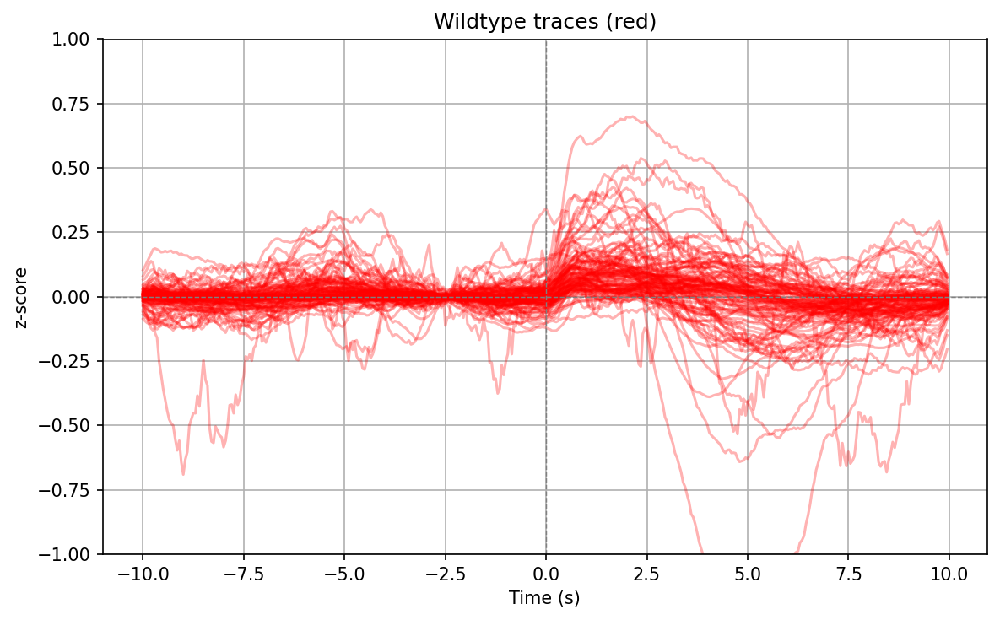

In [30]:
# define your color mapping for genotypes
genotype_colors = {'TH-Cre': 'blue', 'Wildtype': 'red'}

# choose which event/region/channel you want to plot
target_event   = 'before_dispimg_hit'   # <– change as needed
target_region  = 'mPFC'                 # <– change as needed
target_channel = 'G'                    # <– change as needed

# build the time axis (xs) if not already in the namespace
interval_start = config.peak_interval_config["interval_start"]
interval_end   = config.peak_interval_config["interval_end"]
fps            = config.PLOTTING_CONFIG['cpt']['fps']
xs = np.arange(-interval_start, interval_end) / fps

def plot_genotype_traces(sessions, genotype, ax, smoothing_len=10):
    color = genotype_colors[genotype]
    for session in sessions:
        if session.genotype != genotype:
            continue
        info = session.signal_info.get((target_region, target_channel, target_event))
        if info is None:
            continue
        mat = info['signal_matrix']
        if mat.size == 0:
            continue

        ys = np.mean(mat, axis=0)
        ys = np.convolve(ys, np.ones(smoothing_len)/smoothing_len, mode='same')
        ax.plot(xs, ys, color=color, alpha=0.3)

    ax.set_title(f"{genotype} traces ({color})")
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('z‑score')
    ax.axhline(0, color='grey', linestyle='--', linewidth=0.7)
    ax.axvline(0, color='grey', linestyle='--', linewidth=0.7)
    ax.grid(True)
    ax.set_ylim(-1, 1)

# === TH‑Cre (blue) ===
fig, ax = plt.subplots(dpi=150, figsize=(8,5))
plot_genotype_traces(sessions, 'TH-Cre', ax)
fig.tight_layout()

# === Wildtype (red) ===
fig, ax = plt.subplots(dpi=150, figsize=(8,5))
plot_genotype_traces(sessions, 'Wildtype', ax)
fig.tight_layout()

plt.show()


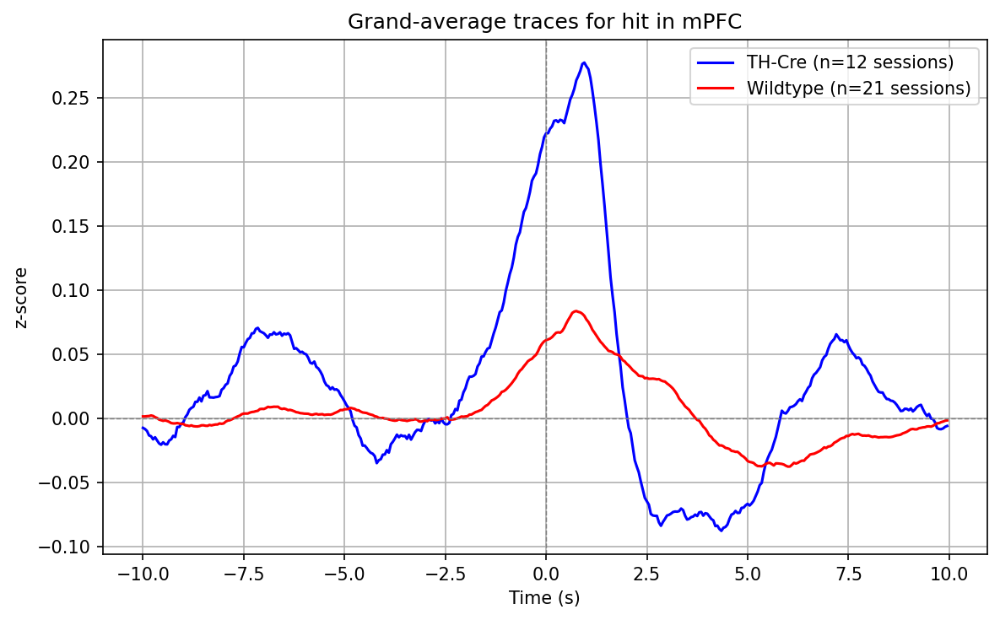

In [ ]:
# define the event/region/channel you want
target_event   = 'before_dispimg_hit'   # ← change as needed
target_region  = 'mPFC'                 # ← change as needed
target_channel = 'G'                    # ← change as needed

# reuse your color map
genotype_colors = {'TH-Cre': 'blue', 'Wildtype': 'red'}

# build time axis if not already present
interval_start = config.peak_interval_config["interval_start"]
interval_end   = config.peak_interval_config["interval_end"]
fps            = config.PLOTTING_CONFIG['cpt']['fps']
xs = np.arange(-interval_start, interval_end) / fps

# collect all matrices per genotype
grouped = {'TH-Cre': [], 'Wildtype': []}
for session in sessions:
    mat = session.signal_info.get((target_region, target_channel, target_event), {}).get('signal_matrix')
    if mat is None or mat.size == 0 and session.drug_info['name'] != :
        continue
    print()
    grouped[session.genotype].append(mat)

# stack and average
mean_traces = {}
for geno, mats in grouped.items():
    if not mats:
        continue
    all_trials = np.vstack(mats)  # stack across sessions
    ys = np.mean(all_trials, axis=0)
    mean_traces[geno] = np.convolve(ys, np.ones(10)/10, mode='same')  # smoothing_len=10

# plot both on one figure
fig, ax = plt.subplots(dpi=150, figsize=(8,5))
for geno, ys in mean_traces.items():
    ax.plot(xs, ys, label=f"{geno} (n={len(grouped[geno])} sessions)", color=genotype_colors[geno])
ax.set_title(f"Grand‑average traces for {target_event} in {target_region}")
ax.set_xlabel('Time (s)')
ax.set_ylabel('z‑score')
ax.axhline(0, color='grey', linestyle='--', linewidth=0.7)
ax.axvline(0, color='grey', linestyle='--', linewidth=0.7)
ax.legend()
ax.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
vehic